In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# !pip install tensorflow

In [3]:
main_path = r'.'
data_path = main_path+'/data'
import sys
sys.path.append(main_path)
from BayDS.lib.pipeline import *
from typing import List, Set, Dict, Optional, Any, Tuple, Type, Union
from BayDS.lib.io import *
from BayDS.lib.training import *
import os
import pickle
import gc

In [4]:
p = Pipeline(working_folder=f'{main_path}/Snapshots/Rating')
p.add_node(LoaderNode, None, 'train',
           params={
               'input_directory': data_path,
               'file': 'onetwotrip_challenge_train.csv'
           })
p.add_node(LoaderNode, None, 'test',
           params={
               'input_directory': data_path,
               'file': 'onetwotrip_challenge_test.csv'
           })
p.run()


---------------------------
0: LoaderNode [2020-01-05 16:57:27]
params:
 {'input_directory': './data', 'file': 'onetwotrip_challenge_train.csv'}
---------------------------
1: LoaderNode [2020-01-05 16:57:27]
params:
 {'input_directory': './data', 'file': 'onetwotrip_challenge_test.csv'}


In [5]:
def mix_train_test(dfs):
    df_train, df_test = dfs
    df_train['orderid'] = df_train['orderid'] + 1000000
    df_train = df_train.set_index('orderid')
    df_test = df_test.set_index('orderid')
    data = pd.concat([df_train, df_test], axis=0, sort=False )
    data.fillna(-1,inplace=True)
    return data

p.add_node(FunctionNode, ('train','test'),'data',
           params={
               'function': mix_train_test
           })
p.run()

---------------------------
2: FunctionNode [2020-01-05 16:57:29]
params:
 {'function': <function mix_train_test at 0x00000208EFDBFBF8>}


In [6]:
p.add_node(EraserNode, params={
    'remove_keys': ['train', 'test']
})
p.run()

---------------------------
3: EraserNode [2020-01-05 16:57:30]
params:
 {'remove_keys': ['train', 'test']}


In [7]:
p.add_node(ReduceMemoryUsageNode, 'data','data',
               params={
                   'verbose': True
               })
p.run()

---------------------------
4: ReduceMemoryUsageNode [2020-01-05 16:57:30]
params:
 {'verbose': True}
Column userid: object -> object, na_count=0, n_uniq=378449
Column field0: int64 -> int16, na_count=0, n_uniq=503
Column field1: float64 -> float32, na_count=0, n_uniq=317
Column field2: int64 -> int8, na_count=0, n_uniq=12
Column field3: int64 -> int8, na_count=0, n_uniq=12
Column field4: int64 -> int16, na_count=0, n_uniq=756
Column field5: int64 -> int8, na_count=0, n_uniq=2
Column field6: int64 -> int16, na_count=0, n_uniq=212
Column field7: int64 -> int8, na_count=0, n_uniq=2
Column field8: int64 -> int8, na_count=0, n_uniq=2
Column field9: int64 -> int8, na_count=0, n_uniq=5
Column field10: int64 -> int8, na_count=0, n_uniq=2
Column field11: int64 -> int8, na_count=0, n_uniq=24
Column field12: int64 -> int16, na_count=0, n_uniq=316
Column field13: int64 -> int16, na_count=0, n_uniq=929
Column field14: float64 -> float32, na_count=0, n_uniq=199
Column field15: int64 -> int8, na_cou

In [8]:
def set_categorical_features(df):
    cat_fields = ['field12', 'field26', 'field27', 'field29','userid']
    for f in cat_fields:
        df[f] = pd.Categorical(df[f])
    return df

p.add_node(FunctionNode, 'data','data',
           params={
               'function': set_categorical_features
           })
p.run()


---------------------------
5: FunctionNode [2020-01-05 16:57:35]
params:
 {'function': <function set_categorical_features at 0x000002088295E598>}


## Features

In [9]:
### Add binarized features as categorical
p.data['data']['price1'] =(p.data['data']['field1'] / 0.077571 + 0.076571896011859 + 11).astype(int)
p.data['data']['price2'] = (p.data['data']['field14'] / 0.140066 + 6.721411648347225).astype(int)

num_to_cat=[f'field{q}' for q in [0,6,13,16,17,22,25]] + ['price1', 'price2']
for f in num_to_cat:
    qcut_data = pd.qcut(p.data['data'][f],10, retbins=True, duplicates='drop',precision=3)[0]
    qcut_data = qcut_data.replace({c:i for i,c in enumerate(qcut_data.dtypes.categories)}).astype(np.uint8)
    p.data['data'][f'{f}bin'] = pd.Categorical(qcut_data)
num_bin_features = [f'{f}bin' for f in num_to_cat]


In [10]:
# p.data['data']['order_till_hour'] = p.data['data']['field21'].astype(str)+'_'+p.data['data']['field2'].astype(str)+'_'+p.data['data']['field18'].astype(str)+'_'+p.data['data']['field11'].astype(str)
# p.data['data']['order_till_weekday'] = p.data['data']['field21'].astype(str)+'_'+p.data['data']['field2'].astype(str)+'_'+p.data['data']['field18'].astype(str)
# p.data['data']['order_till_month'] = p.data['data']['field21'].astype(str)+'_'+p.data['data']['field2'].astype(str)
# p.data['data']['lang_country'] = p.data['data']['field27'].astype(str)+'_'+p.data['data']['field12'].astype(str)
# new_cat_features = ['order_till_hour', 'order_till_weekday','order_till_month', 'lang_country']

# LE=LabelEncoderPopularity()

# for newcat in new_cat_features:
#     LE.fit(p.data['data'][newcat])
#     d = LE.transform(p.data['data'][newcat])
#     p.data['data'][newcat] = pd.Categorical(d)


In [11]:
 p.data['data']['userid'] = pd.Categorical(p.data['data']['userid'])

In [12]:
gb_features = []
num_features = []

for col in p.data['data'].columns:
    if col.startswith('goal') or col.startswith('indicator_'):
        continue
        
    print (col, p.data['data'][col].dtype.name)
    if p.data['data'][col].dtype.name == 'category' or len(p.data['data'][col].value_counts()) <= 2:
        gb_features.append(col)
    if p.data['data'][col].dtype.name != 'category':
        num_features.append(col)
        
    

userid category
field0 int16
field1 float32
field2 int8
field3 int8
field4 int16
field5 int8
field6 int16
field7 int8
field8 int8
field9 int8
field10 int8
field11 int8
field12 category
field13 int16
field14 float32
field15 int8
field16 int16
field17 int16
field18 int8
field19 int8
field20 int8
field21 int8
field22 int16
field23 int8
field24 int8
field25 int16
field26 category
field27 category
field28 int8
field29 category
price1 int32
price2 int32
field0bin category
field6bin category
field13bin category
field16bin category
field17bin category
field22bin category
field25bin category
price1bin category
price2bin category


In [13]:
p.data['data'].to_pickle('./FE/initial_data.pkl')

## First order group rating

In [13]:
from sklearn.model_selection import GroupKFold, KFold

NFOLDS = 3
folds = GroupKFold(n_splits=NFOLDS)
params = {
          'objective': 'binary',
          "metric": 'auc',
          "verbosity": -1,
          'learning_rate': 0.02,
          'max_depth':0
         }
train_options = {
        "model_type":'lgb',
        "params": params,
        "eval_metric":'auc',
        'early_stopping_rounds': 100,
        'n_estimators': 500,
        'averaging': 'rank',
        'use_groups': False,
        'fold_name': folds.__class__.__name__,
        'n_splits': NFOLDS
    }

train_idx = p.data['data'][p.data['data']['goal1']>=0].index
y = p.data['data'].loc[train_idx]['goal1']
groups = p.data['data'].loc[train_idx]['userid']

In [14]:
rating={}

******
 Starting userid
---------------------------
6: AddGroupNumericalAggregatesNode [2020-01-05 12:40:01]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['userid'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 12:40:32 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[160]	training's auc: 0.776313	training's auc: 0.776472	valid_1's auc: 0.632597	valid_1's auc: 0.632778
Fold 2 started at Sun Jan  5 12:40:49 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[190]	training's auc: 0.791173	training's auc: 0.791097	valid_1's auc: 0.63141	valid_

CV mean score: 0.6804, std: 0.0052.
---------------------------
17: EraserNode [2020-01-05 12:46:33]
params:
 {'remove_keys': ['agg_field12']}
******
 Starting field21
---------------------------
18: AddGroupNumericalAggregatesNode [2020-01-05 12:46:33]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field21'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 12:46:37 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[188]	training's auc: 0.789046	training's auc: 0.789046	valid_1's auc: 0.660764	valid_1's auc: 0.660764
Fold 2 started at Sun Jan  5 12:46:57 2020
Training until validation scores don't improve f

Fold 3 started at Sun Jan  5 12:51:42 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[203]	training's auc: 0.789515	training's auc: 0.789515	valid_1's auc: 0.675347	valid_1's auc: 0.675347
CV mean score: 0.6694, std: 0.0072.
---------------------------
29: EraserNode [2020-01-05 12:52:05]
params:
 {'remove_keys': ['agg_field6bin']}
******
 Starting field13bin
---------------------------
30: AddGroupNumericalAggregatesNode [2020-01-05 12:52:05]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field13bin'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 12:52:09 2020
Training until validation sco

Fold 2 started at Sun Jan  5 12:57:56 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[92]	training's auc: 0.746765	training's auc: 0.74676	valid_1's auc: 0.670162	valid_1's auc: 0.670161
Fold 3 started at Sun Jan  5 12:58:10 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[168]	training's auc: 0.792146	training's auc: 0.792146	valid_1's auc: 0.671507	valid_1's auc: 0.671507
CV mean score: 0.6667, std: 0.0058.
---------------------------
41: EraserNode [2020-01-05 12:58:30]
params:
 {'remove_keys': ['agg_price1bin']}
******
 Starting price2bin
---------------------------
42: AddGroupNumericalAggregatesNode [2020-01-05 12:58:31]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22',

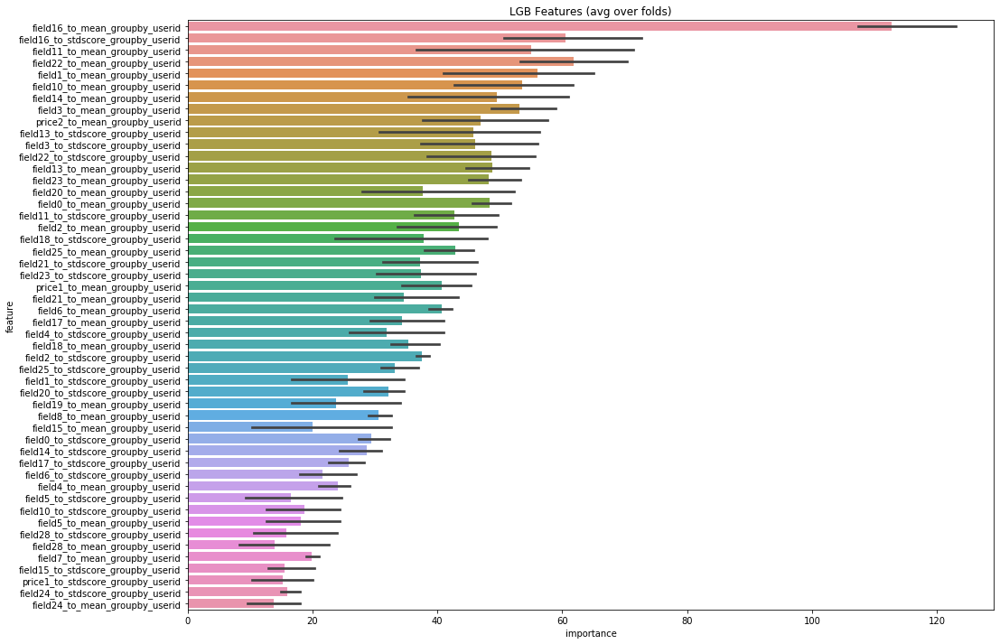

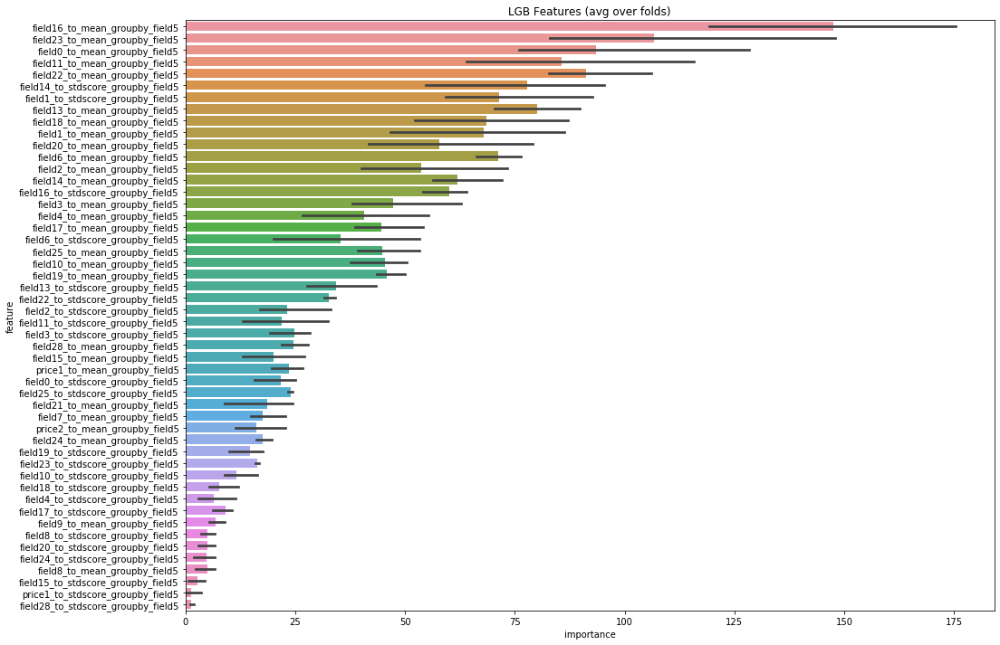

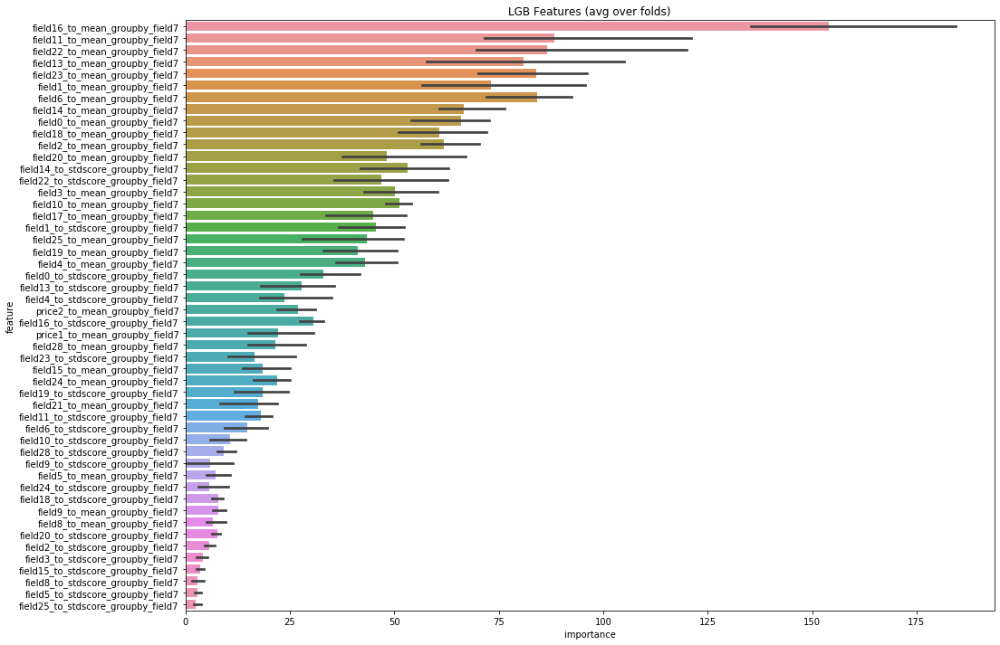

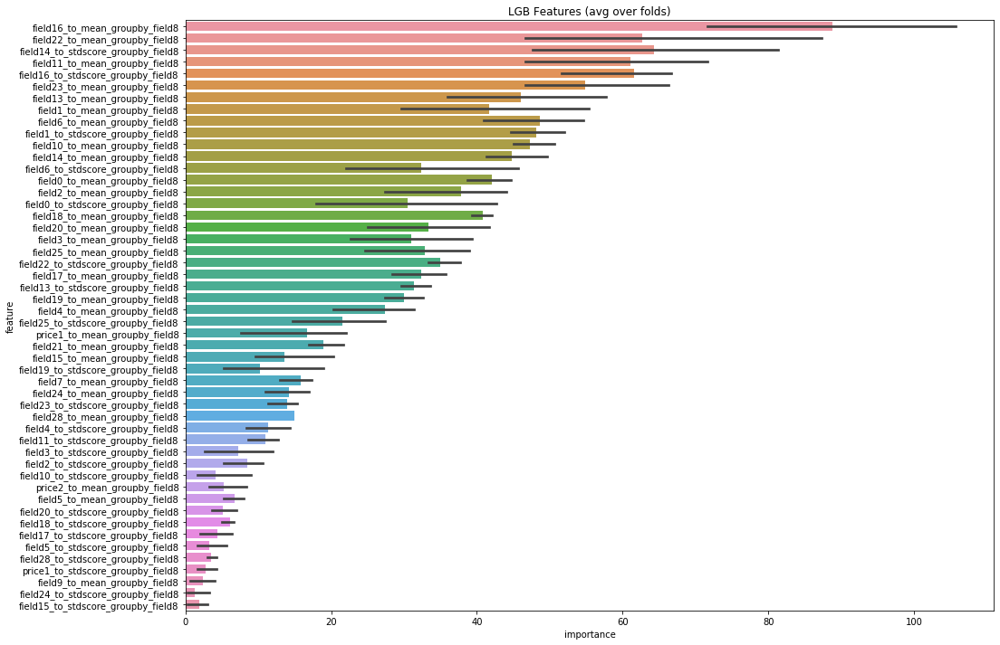

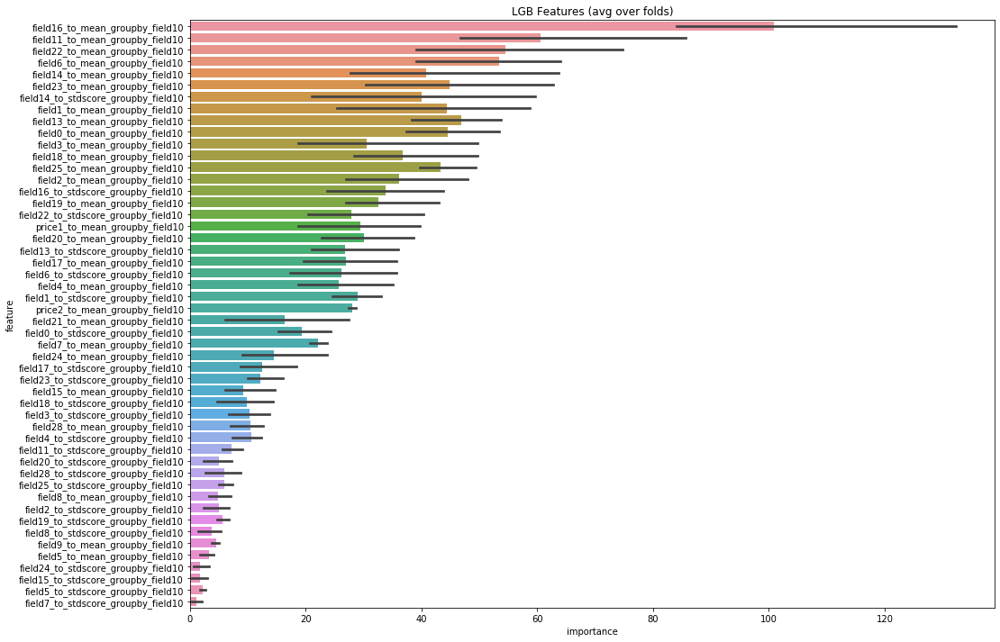

...

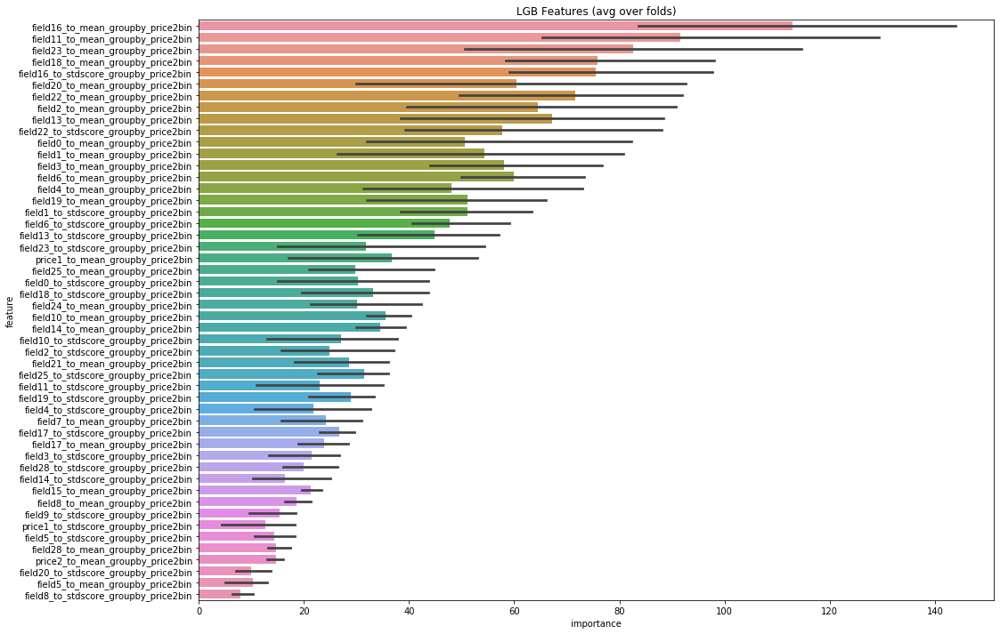

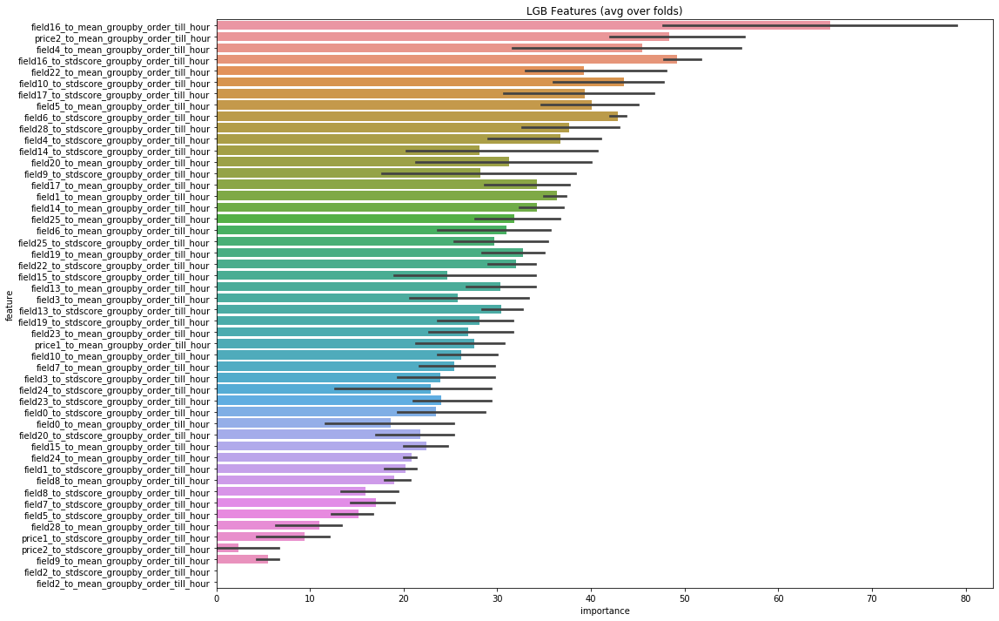

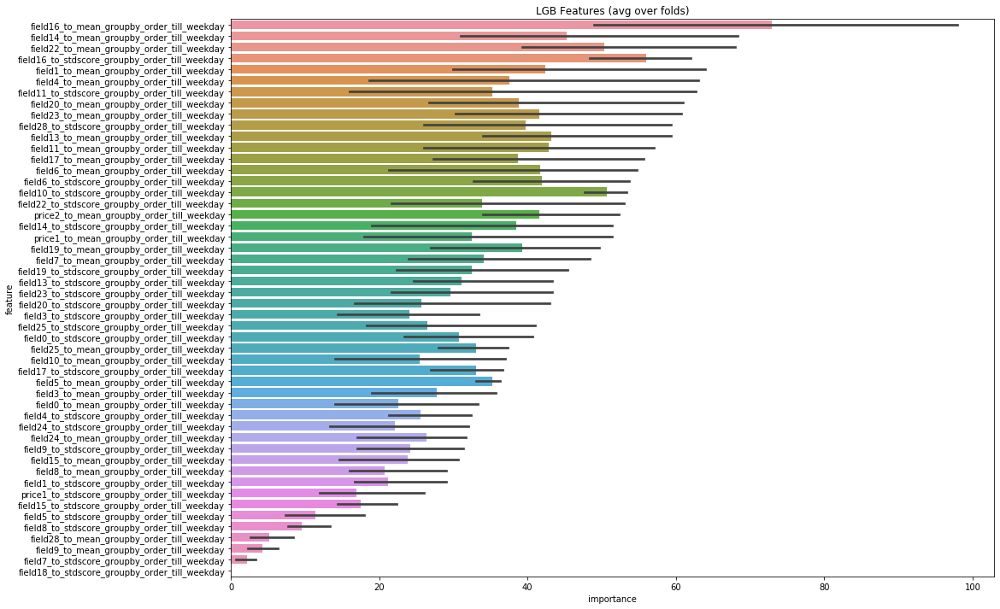

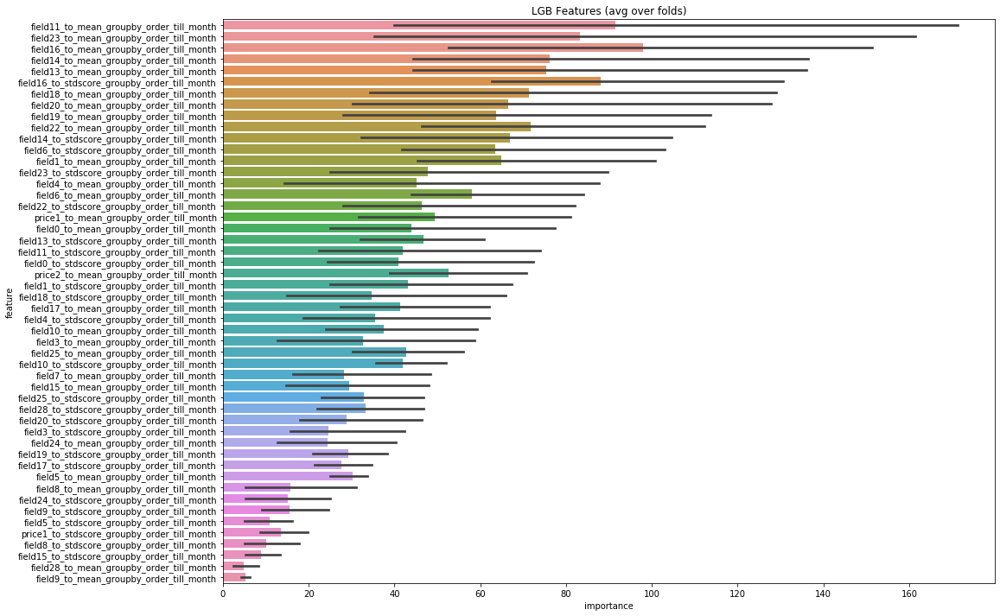

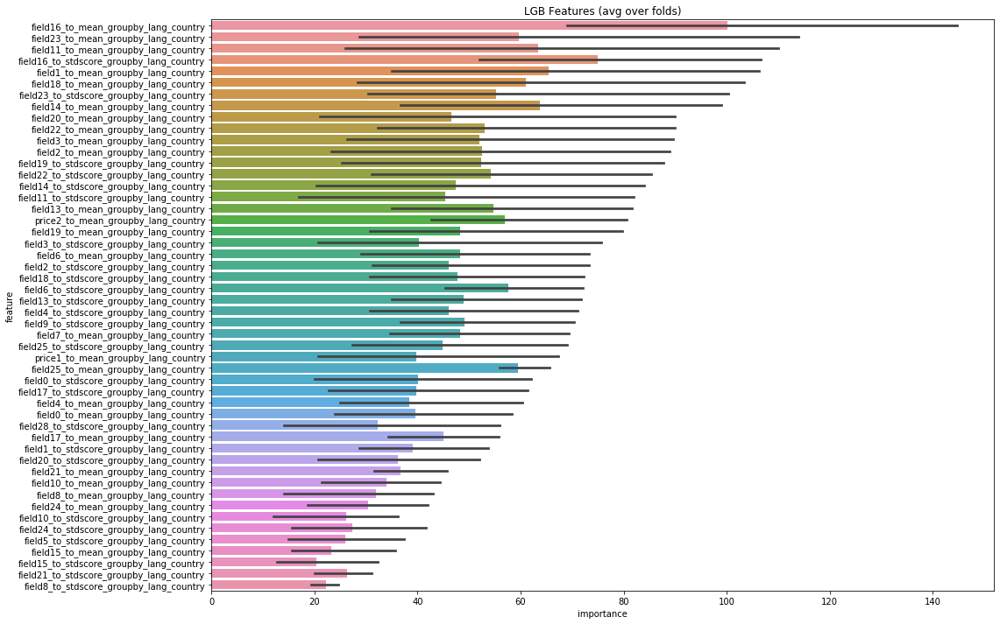

In [15]:
for gb in gb_features:
    print(f'******\n Starting {gb}')
    p.add_node(AddGroupNumericalAggregatesNode, 'data',f'agg_{gb}',
               params={
                   'features': [f for f in num_features if f != gb], 
                   'group_by': [gb],
                   'to_mean': True,
                   'to_std_score': True,
                   'to_std': False,
                   'to_minmax': False
               })
    p.run()    
    X =  p.data[f'agg_{gb}'].loc[train_idx]
    result_dict = train_model_classification_vb( X=X, 
                                             X_test=None, 
                                             columns=X.columns,
                                             y=y, 
                                             params=params, folds=folds,
                                             model_type=train_options['model_type'], 
                                             plot_feature_importance=True,
                                             verbose=-1, early_stopping_rounds=train_options['early_stopping_rounds'],
                                             n_estimators=train_options['n_estimators'], 
                                             averaging=train_options['averaging'],
                                             groups=groups,
                                             n_jobs=-1)
    score = sum(result_dict['scores'])/len(result_dict['scores'])
    rating[f'agg_{gb}'] = (score, result_dict)
    pickle.dump(rating,open("./temp/rating_group.pkl",'wb'))
    p.add_node(EraserNode, None,None,
           params={
               'remove_keys': [f'agg_{gb}']
           })
    p.run()
    gc.collect()
    

In [17]:
rating_scores = {k:v[0] for k,v in rating.items()}

In [18]:
rating_scores

{'agg_userid': 0.6350086008220933,
 'agg_field5': 0.6671256950776822,
 'agg_field7': 0.6678934147028427,
 'agg_field8': 0.6706437053642462,
 'agg_field10': 0.6659085170151551,
 'agg_field12': 0.6804336085292215,
 'agg_field21': 0.6676028066765252,
 'agg_field26': 0.6662645113377631,
 'agg_field27': 0.6665089143137933,
 'agg_field29': 0.667028862360154,
 'agg_field0bin': 0.6665870850248937,
 'agg_field6bin': 0.6694353296168449,
 'agg_field13bin': 0.6688530381205696,
 'agg_field16bin': 0.6677314314717385,
 'agg_field17bin': 0.6687220442300096,
 'agg_field22bin': 0.6674676067145969,
 'agg_field25bin': 0.6686353138090277,
 'agg_price1bin': 0.6667242965162853,
 'agg_price2bin': 0.6650839983700806,
 'agg_order_till_hour': 0.6617316328070805,
 'agg_order_till_weekday': 0.6648095675729396,
 'agg_order_till_month': 0.6658566916491155,
 'agg_lang_country': 0.6805241619109449}

In [19]:
sorted_rating = sorted(rating_scores.items(),key=lambda q: q[1],reverse=True)

In [20]:
sorted_rating

[('agg_lang_country', 0.6805241619109449),
 ('agg_field12', 0.6804336085292215),
 ('agg_field8', 0.6706437053642462),
 ('agg_field6bin', 0.6694353296168449),
 ('agg_field13bin', 0.6688530381205696),
 ('agg_field17bin', 0.6687220442300096),
 ('agg_field25bin', 0.6686353138090277),
 ('agg_field7', 0.6678934147028427),
 ('agg_field16bin', 0.6677314314717385),
 ('agg_field21', 0.6676028066765252),
 ('agg_field22bin', 0.6674676067145969),
 ('agg_field5', 0.6671256950776822),
 ('agg_field29', 0.667028862360154),
 ('agg_price1bin', 0.6667242965162853),
 ('agg_field0bin', 0.6665870850248937),
 ('agg_field27', 0.6665089143137933),
 ('agg_field26', 0.6662645113377631),
 ('agg_field10', 0.6659085170151551),
 ('agg_order_till_month', 0.6658566916491155),
 ('agg_price2bin', 0.6650839983700806),
 ('agg_order_till_weekday', 0.6648095675729396),
 ('agg_order_till_hour', 0.6617316328070805),
 ('agg_userid', 0.6350086008220933)]

## Second order group rating

In [28]:
ultimate_features = ['field12', 'field8', 'field6bin']

In [34]:
second_rating={}

In [24]:
gb_features = ['userid',
 'field5',
 'field7',
 'field8',
 'field10',
 'field12',
 'field21',
 'field26',
 'field27',
 'field29',
 'field0bin',
 'field6bin',
 'field13bin',
 'field16bin',
 'field17bin',
 'field22bin',
 'field25bin',
 'price1bin',
 'price2bin']

******
 Starting field12+userid
---------------------------
53: AddGroupNumericalAggregatesNode [2020-01-05 13:18:08]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field12', 'userid'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 13:18:44 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[266]	training's auc: 0.751474	training's auc: 0.751461	valid_1's auc: 0.607918	valid_1's auc: 0.607969
Fold 2 started at Sun Jan  5 13:19:07 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[79]	training's auc: 0.687688	training's auc: 0.687782	valid_1's 

Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[185]	training's auc: 0.80896	training's auc: 0.80896	valid_1's auc: 0.685508	valid_1's auc: 0.685508
CV mean score: 0.6784, std: 0.0057.
---------------------------
64: EraserNode [2020-01-05 13:25:27]
params:
 {'remove_keys': ['agg_field12_field21']}
******
 Starting field12+field26
---------------------------
65: AddGroupNumericalAggregatesNode [2020-01-05 13:25:27]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field12', 'field26'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 13:25:32 2020
Training until validation scores don't improve for 100 

Early stopping, best iteration is:
[392]	training's auc: 0.885961	training's auc: 0.885961	valid_1's auc: 0.666911	valid_1's auc: 0.666911
Fold 2 started at Sun Jan  5 13:32:06 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[174]	training's auc: 0.812208	training's auc: 0.812208	valid_1's auc: 0.679843	valid_1's auc: 0.679843
Fold 3 started at Sun Jan  5 13:32:23 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[164]	training's auc: 0.81544	training's auc: 0.81544	valid_1's auc: 0.68269	valid_1's auc: 0.68269
CV mean score: 0.6765, std: 0.0069.
---------------------------
76: EraserNode [2020-01-05 13:32:44]
params:
 {'remove_keys': ['agg_field12_field13bin']}
******
 Starting field12+field16bin
---------------------------
77: AddGroupNumericalAggregatesNode [2020-01-05 13:32:44]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field

Fold 1 started at Sun Jan  5 13:38:37 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[136]	training's auc: 0.800286	training's auc: 0.800286	valid_1's auc: 0.661537	valid_1's auc: 0.661537
Fold 2 started at Sun Jan  5 13:38:54 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[162]	training's auc: 0.808769	training's auc: 0.808769	valid_1's auc: 0.676733	valid_1's auc: 0.676733
Fold 3 started at Sun Jan  5 13:39:14 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[197]	training's auc: 0.824901	training's auc: 0.824901	valid_1's auc: 0.677703	valid_1's auc: 0.677703
CV mean score: 0.6720, std: 0.0074.
---------------------------
88: EraserNode [2020-01-05 13:39:39]
params:
 {'remove_keys': ['agg_field12_price2bin']}
******
 Starting field8+userid
---------------------------
89: AddGroupNumericalAggregatesNode [2020-01-05 13:39

Fold 1 started at Sun Jan  5 13:45:23 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[112]	training's auc: 0.754524	training's auc: 0.754523	valid_1's auc: 0.660077	valid_1's auc: 0.660078
Fold 2 started at Sun Jan  5 13:45:39 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[88]	training's auc: 0.737209	training's auc: 0.737216	valid_1's auc: 0.667303	valid_1's auc: 0.667314
Fold 3 started at Sun Jan  5 13:45:52 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[164]	training's auc: 0.780152	training's auc: 0.780152	valid_1's auc: 0.672708	valid_1's auc: 0.672708
CV mean score: 0.6667, std: 0.0052.
---------------------------
100: EraserNode [2020-01-05 13:46:12]
params:
 {'remove_keys': ['agg_field8_field21']}
******
 Starting field8+field26
---------------------------
101: AddGroupNumericalAggregatesNode [2020-01-05 13:46:

Fold 1 started at Sun Jan  5 13:51:17 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[186]	training's auc: 0.805964	training's auc: 0.805964	valid_1's auc: 0.662175	valid_1's auc: 0.662175
Fold 2 started at Sun Jan  5 13:51:37 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[148]	training's auc: 0.78272	training's auc: 0.78272	valid_1's auc: 0.671973	valid_1's auc: 0.671973
Fold 3 started at Sun Jan  5 13:51:55 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[186]	training's auc: 0.797848	training's auc: 0.797847	valid_1's auc: 0.675967	valid_1's auc: 0.675967
CV mean score: 0.6700, std: 0.0058.
---------------------------
112: EraserNode [2020-01-05 13:52:17]
params:
 {'remove_keys': ['agg_field8_field13bin']}
******
 Starting field8+field16bin
---------------------------
113: AddGroupNumericalAggregatesNode [2020-01-05 1

Fold 1 started at Sun Jan  5 13:57:08 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[162]	training's auc: 0.79776	training's auc: 0.79776	valid_1's auc: 0.657945	valid_1's auc: 0.657945
Fold 2 started at Sun Jan  5 13:57:27 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[127]	training's auc: 0.764045	training's auc: 0.764043	valid_1's auc: 0.674233	valid_1's auc: 0.67423
Fold 3 started at Sun Jan  5 13:57:44 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[97]	training's auc: 0.747527	training's auc: 0.747526	valid_1's auc: 0.671479	valid_1's auc: 0.671486
CV mean score: 0.6679, std: 0.0071.
---------------------------
124: EraserNode [2020-01-05 13:58:00]
params:
 {'remove_keys': ['agg_field8_price2bin']}
******
 Starting field6bin+userid
---------------------------
125: AddGroupNumericalAggregatesNode [2020-01-05 13:58

Fold 1 started at Sun Jan  5 14:03:39 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[200]	training's auc: 0.821585	training's auc: 0.821585	valid_1's auc: 0.671594	valid_1's auc: 0.671594
Fold 2 started at Sun Jan  5 14:04:02 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[123]	training's auc: 0.777616	training's auc: 0.777617	valid_1's auc: 0.678928	valid_1's auc: 0.678928
Fold 3 started at Sun Jan  5 14:04:19 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[273]	training's auc: 0.844455	training's auc: 0.844455	valid_1's auc: 0.687947	valid_1's auc: 0.687947
CV mean score: 0.6795, std: 0.0067.
---------------------------
136: EraserNode [2020-01-05 14:04:47]
params:
 {'remove_keys': ['agg_field6bin_field12']}
******
 Starting field6bin+field21
---------------------------
137: AddGroupNumericalAggregatesNode [2020-01-05

Fold 1 started at Sun Jan  5 14:09:40 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[157]	training's auc: 0.790493	training's auc: 0.790493	valid_1's auc: 0.661525	valid_1's auc: 0.661525
Fold 2 started at Sun Jan  5 14:09:59 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[111]	training's auc: 0.757738	training's auc: 0.757738	valid_1's auc: 0.673787	valid_1's auc: 0.673787
Fold 3 started at Sun Jan  5 14:10:14 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[195]	training's auc: 0.803267	training's auc: 0.803267	valid_1's auc: 0.673481	valid_1's auc: 0.673481
CV mean score: 0.6696, std: 0.0057.
---------------------------
148: EraserNode [2020-01-05 14:10:36]
params:
 {'remove_keys': ['agg_field6bin_field13bin']}
******
 Starting field6bin+field16bin
---------------------------
149: AddGroupNumericalAggregatesNode [2020

Fold 1 started at Sun Jan  5 14:16:13 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[143]	training's auc: 0.786423	training's auc: 0.786422	valid_1's auc: 0.656173	valid_1's auc: 0.656173
Fold 2 started at Sun Jan  5 14:16:31 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[112]	training's auc: 0.760927	training's auc: 0.76093	valid_1's auc: 0.674144	valid_1's auc: 0.67414
Fold 3 started at Sun Jan  5 14:16:46 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[205]	training's auc: 0.808972	training's auc: 0.808972	valid_1's auc: 0.671596	valid_1's auc: 0.671596
CV mean score: 0.6673, std: 0.0079.
---------------------------
160: EraserNode [2020-01-05 14:17:10]
params:
 {'remove_keys': ['agg_field6bin_price2bin']}


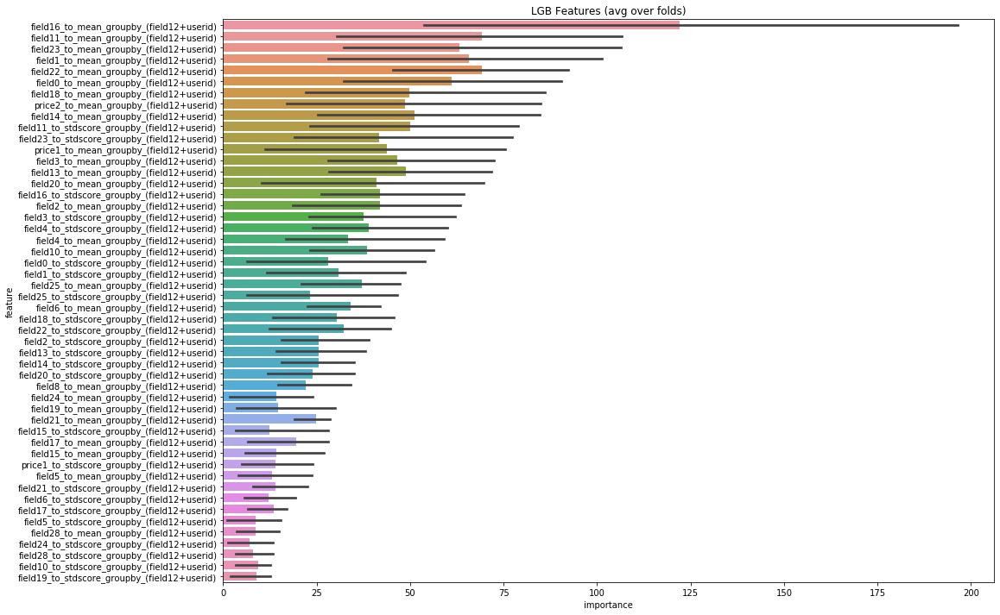

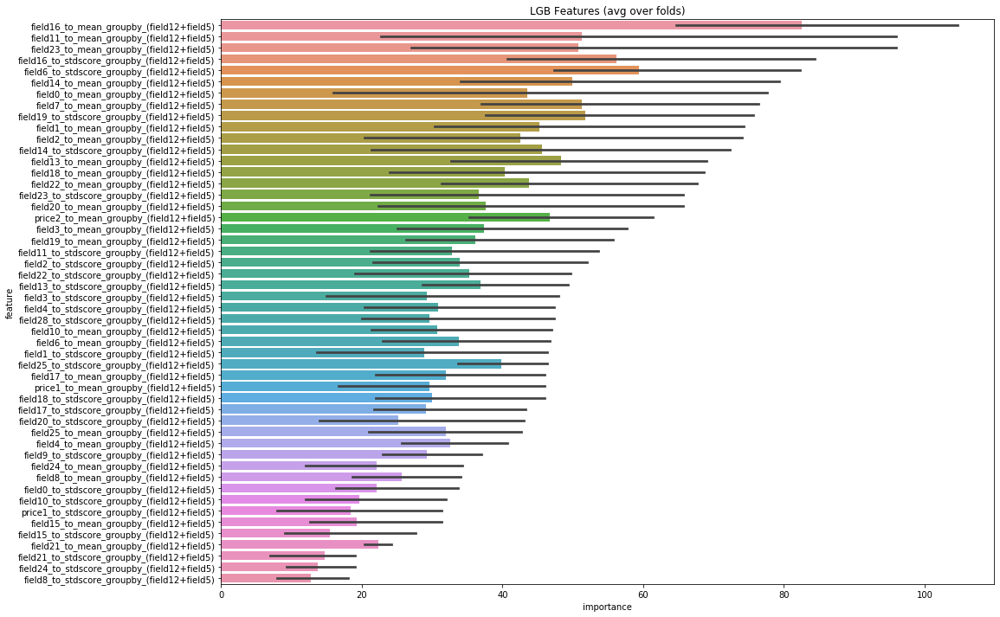

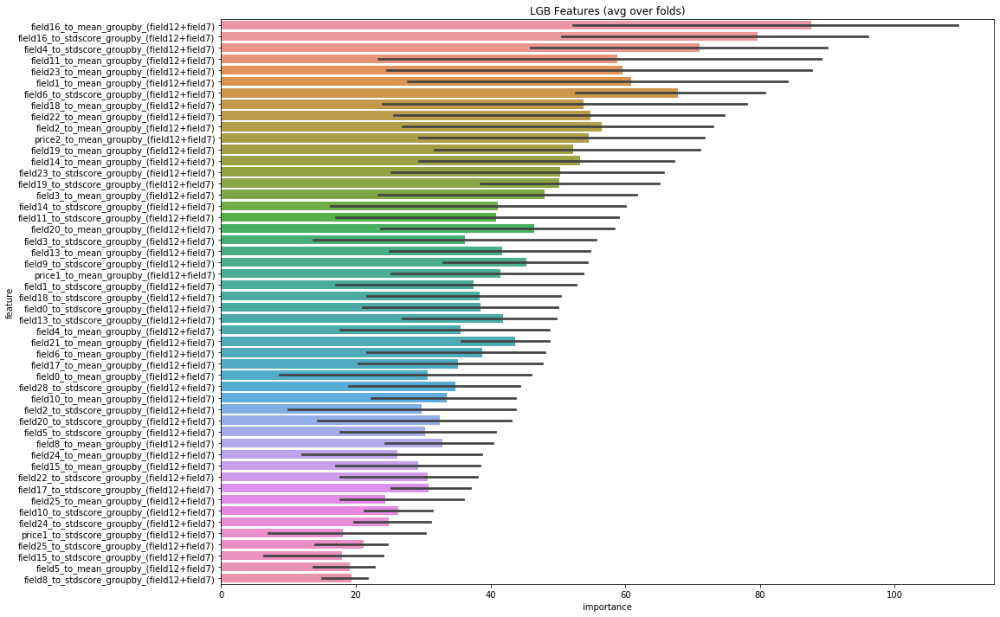

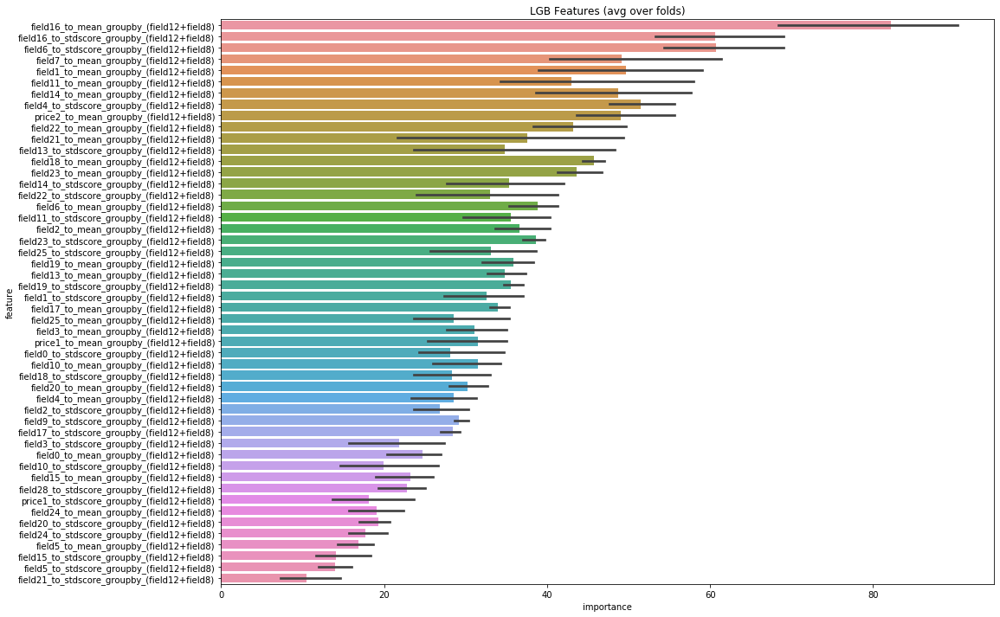

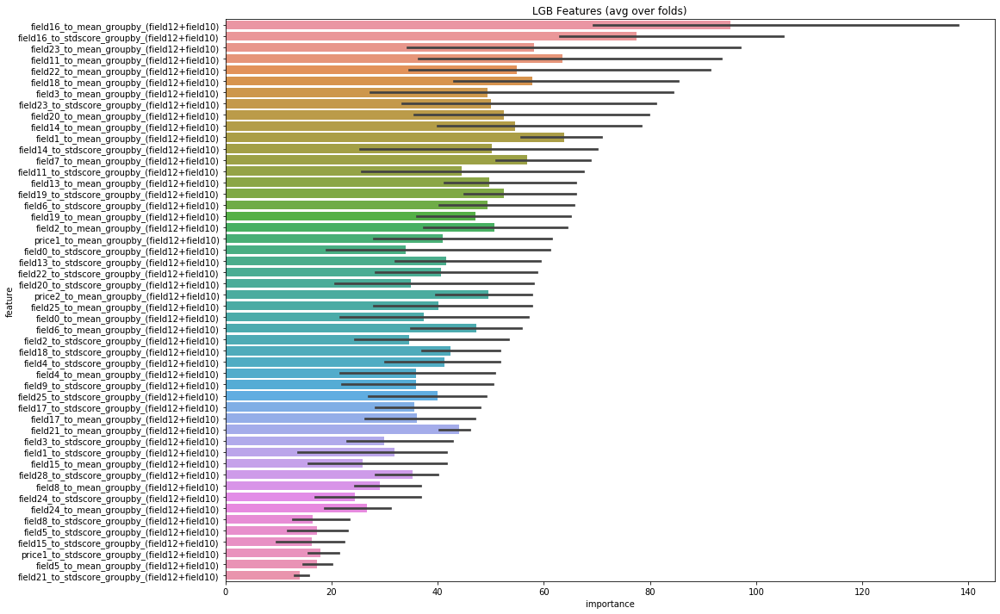

...

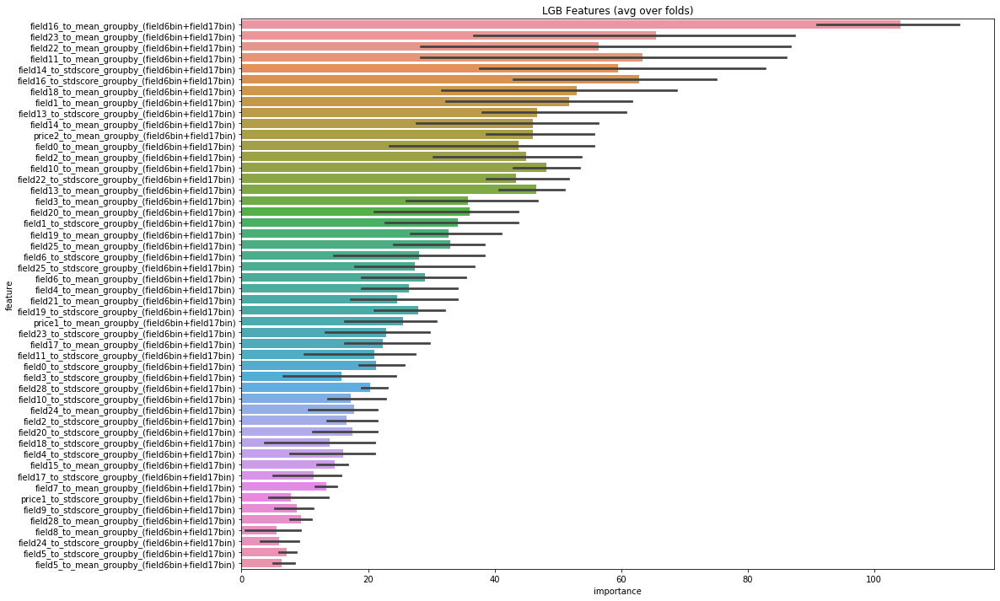

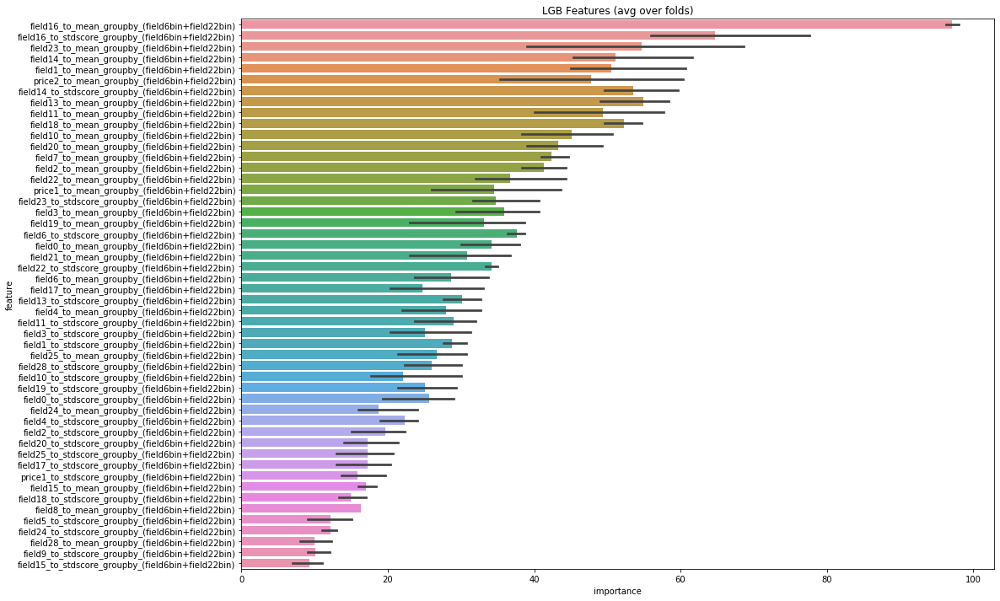

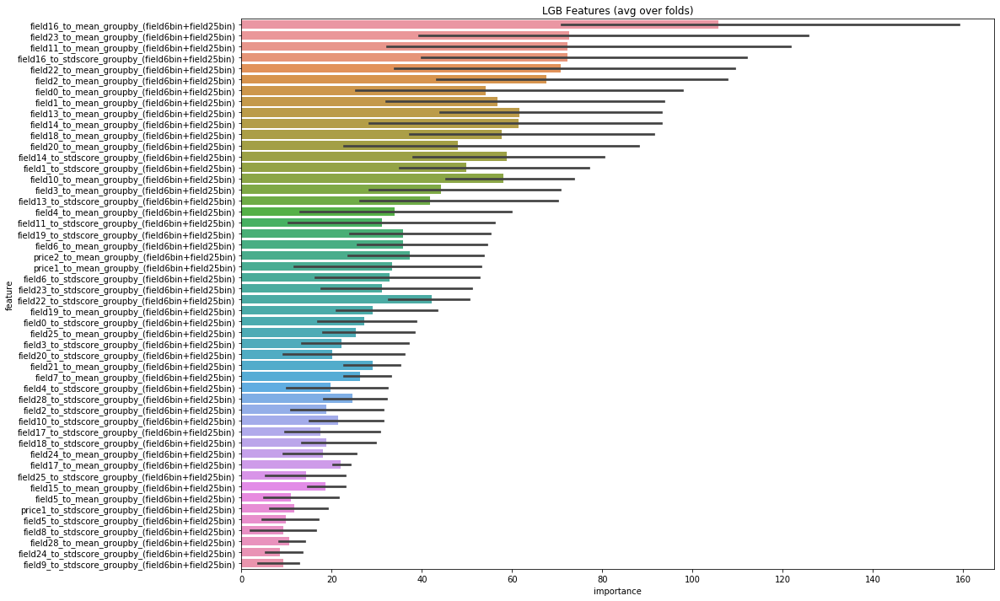

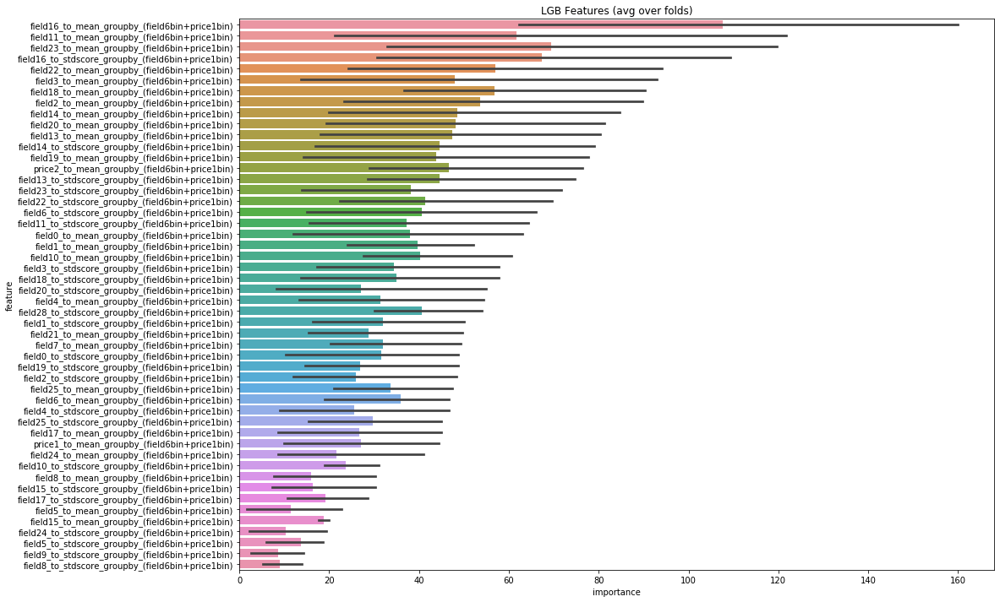

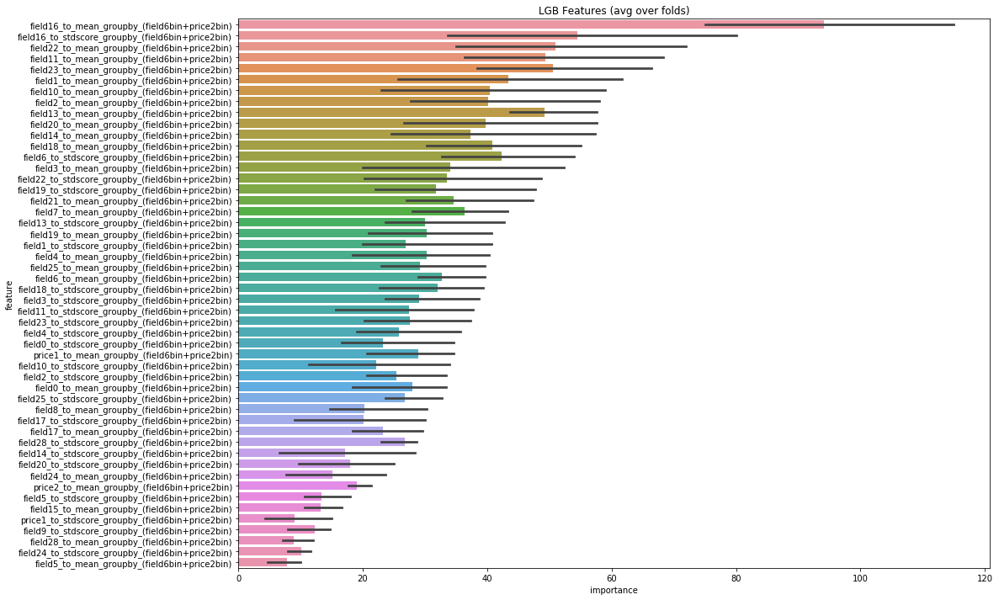

In [35]:
for uf in ultimate_features:
    for gb in gb_features:
        if gb == uf:
            continue
            
        print(f'******\n Starting {uf}+{gb}')
        p.add_node(AddGroupNumericalAggregatesNode, 'data',f'agg_{uf}_{gb}',
                   params={
                       'features': [f for f in num_features if f not in (uf,gb)], 
                       'group_by': [uf,gb],
                       'to_mean': True,
                       'to_std_score': True,
                       'to_std': False,
                       'to_minmax': False
                   })
        p.run()    
        X =  p.data[f'agg_{uf}_{gb}'].loc[train_idx]
        result_dict = train_model_classification_vb( X=X, 
                                                 X_test=None, 
                                                 columns=X.columns,
                                                 y=y, 
                                                 params=params, folds=folds,
                                                 model_type=train_options['model_type'], 
                                                 plot_feature_importance=True,
                                                 verbose=-1, early_stopping_rounds=train_options['early_stopping_rounds'],
                                                 n_estimators=train_options['n_estimators'], 
                                                 averaging=train_options['averaging'],
                                                 groups=groups,
                                                 n_jobs=-1)
        score = sum(result_dict['scores'])/len(result_dict['scores'])
        second_rating[f'agg_{uf}_{gb}'] = (score, result_dict)
        pickle.dump(second_rating,open("./temp/rating_group_second.pkl",'wb'))
        p.add_node(EraserNode, None,None,
               params={
                   'remove_keys': [f'agg_{uf}_{gb}']
               })
        p.run()
        gc.collect()

In [36]:
rating_scores2 = {k:v[0] for k,v in second_rating.items()}

In [37]:
sorted_rating2 = sorted(rating_scores2.items(),key=lambda q: q[1],reverse=True)

In [38]:
sorted_rating2

[('agg_field12_field17bin', 0.6806856224978851),
 ('agg_field12_field27', 0.6805241619109449),
 ('agg_field12_field6bin', 0.6794899013076875),
 ('agg_field6bin_field12', 0.6794899013076875),
 ('agg_field12_field5', 0.6791035770798667),
 ('agg_field12_field25bin', 0.6788729205911078),
 ('agg_field12_field21', 0.6784418483751793),
 ('agg_field12_field26', 0.678245632798669),
 ('agg_field12_field7', 0.6782418883328923),
 ('agg_field12_field10', 0.6780104507374564),
 ('agg_field12_field22bin', 0.677921197083588),
 ('agg_field12_field8', 0.6775488562750408),
 ('agg_field8_field12', 0.6775488562750408),
 ('agg_field12_field0bin', 0.6773173857132476),
 ('agg_field12_field29', 0.6770753043504002),
 ('agg_field12_field13bin', 0.6764811981818656),
 ('agg_field12_field16bin', 0.6759725069504281),
 ('agg_field12_price1bin', 0.6751810665860273),
 ('agg_field12_price2bin', 0.6719909621904313),
 ('agg_field6bin_field17bin', 0.670369876945359),
 ('agg_field8_field10', 0.6702074229364542),
 ('agg_field

## Third order groups

In [39]:
ultimate_features1 = ['field12']
ultimate_features2 = ['field17bin','field27','field6bin','field5','field25bin']


In [40]:
third_rating={}

******
 Starting field12+field17bin+userid
---------------------------
161: AddGroupNumericalAggregatesNode [2020-01-05 14:26:26]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field12', 'field17bin', 'userid'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 14:27:05 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[89]	training's auc: 0.694374	training's auc: 0.694078	valid_1's auc: 0.609754	valid_1's auc: 0.609092
Fold 2 started at Sun Jan  5 14:27:16 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[117]	training's auc: 0.710186	training'

Early stopping, best iteration is:
[176]	training's auc: 0.810962	training's auc: 0.810962	valid_1's auc: 0.67739	valid_1's auc: 0.67739
Fold 3 started at Sun Jan  5 14:33:28 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[147]	training's auc: 0.798225	training's auc: 0.798225	valid_1's auc: 0.685886	valid_1's auc: 0.685886
CV mean score: 0.6783, std: 0.0058.
---------------------------
172: EraserNode [2020-01-05 14:33:47]
params:
 {'remove_keys': ['agg_field12_field17bin_field21']}
******
 Starting field12+field17bin+field26
---------------------------
173: AddGroupNumericalAggregatesNode [2020-01-05 14:33:48]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'gro

Fold 1 started at Sun Jan  5 14:39:56 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[208]	training's auc: 0.833165	training's auc: 0.833165	valid_1's auc: 0.669771	valid_1's auc: 0.669771
Fold 2 started at Sun Jan  5 14:40:18 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[161]	training's auc: 0.806188	training's auc: 0.806188	valid_1's auc: 0.678723	valid_1's auc: 0.678723
Fold 3 started at Sun Jan  5 14:40:38 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[269]	training's auc: 0.85159	training's auc: 0.85159	valid_1's auc: 0.683053	valid_1's auc: 0.683053
CV mean score: 0.6772, std: 0.0055.
---------------------------
184: EraserNode [2020-01-05 14:41:06]
params:
 {'remove_keys': ['agg_field12_field17bin_field13bin']}
******
 Starting field12+field17bin+field16bin
---------------------------
185: AddGroupNumericalAggr

Fold 1 started at Sun Jan  5 14:48:11 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[74]	training's auc: 0.686358	training's auc: 0.685793	valid_1's auc: 0.60167	valid_1's auc: 0.602559
Fold 2 started at Sun Jan  5 14:48:22 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[80]	training's auc: 0.680175	training's auc: 0.680491	valid_1's auc: 0.599158	valid_1's auc: 0.599109
Fold 3 started at Sun Jan  5 14:48:33 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[58]	training's auc: 0.667263	training's auc: 0.668029	valid_1's auc: 0.602185	valid_1's auc: 0.600043
CV mean score: 0.6010, std: 0.0013.
---------------------------
196: EraserNode [2020-01-05 14:48:45]
params:
 {'remove_keys': ['agg_field12_field27_userid']}
******
 Starting field12+field27+field5
---------------------------
197: AddGroupNumericalAggregatesNode [2020

Fold 1 started at Sun Jan  5 14:54:51 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[245]	training's auc: 0.851676	training's auc: 0.851676	valid_1's auc: 0.67084	valid_1's auc: 0.67084
Fold 2 started at Sun Jan  5 14:55:16 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[171]	training's auc: 0.813955	training's auc: 0.813955	valid_1's auc: 0.68393	valid_1's auc: 0.683931
Fold 3 started at Sun Jan  5 14:55:37 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[162]	training's auc: 0.808042	training's auc: 0.808042	valid_1's auc: 0.679966	valid_1's auc: 0.679966
CV mean score: 0.6782, std: 0.0055.
---------------------------
208: EraserNode [2020-01-05 14:55:58]
params:
 {'remove_keys': ['agg_field12_field27_field26']}
******
 Starting field12+field27+field29
---------------------------
209: AddGroupNumericalAggregatesNode [2

Fold 1 started at Sun Jan  5 15:01:51 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[246]	training's auc: 0.842474	training's auc: 0.842474	valid_1's auc: 0.669829	valid_1's auc: 0.669829
Fold 2 started at Sun Jan  5 15:02:17 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[160]	training's auc: 0.806864	training's auc: 0.806864	valid_1's auc: 0.681628	valid_1's auc: 0.681628
Fold 3 started at Sun Jan  5 15:02:36 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[208]	training's auc: 0.828103	training's auc: 0.828103	valid_1's auc: 0.679061	valid_1's auc: 0.679061
CV mean score: 0.6768, std: 0.0051.
---------------------------
220: EraserNode [2020-01-05 15:03:00]
params:
 {'remove_keys': ['agg_field12_field27_field17bin']}
******
 Starting field12+field27+field22bin
---------------------------
221: AddGroupNumericalAggregat

******
 Starting field12+field6bin+field5
---------------------------
231: AddGroupNumericalAggregatesNode [2020-01-05 15:09:45]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field12', 'field6bin', 'field5'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 15:09:51 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[248]	training's auc: 0.842677	training's auc: 0.842677	valid_1's auc: 0.669387	valid_1's auc: 0.669387
Fold 2 started at Sun Jan  5 15:10:16 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[146]	training's auc: 0.793847	training's auc: 0.79

Early stopping, best iteration is:
[145]	training's auc: 0.802191	training's auc: 0.802191	valid_1's auc: 0.676409	valid_1's auc: 0.676409
Fold 3 started at Sun Jan  5 15:16:49 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[222]	training's auc: 0.842944	training's auc: 0.842943	valid_1's auc: 0.680367	valid_1's auc: 0.680367
CV mean score: 0.6752, std: 0.0048.
---------------------------
242: EraserNode [2020-01-05 15:17:16]
params:
 {'remove_keys': ['agg_field12_field6bin_field26']}
******
 Starting field12+field6bin+field27
---------------------------
243: AddGroupNumericalAggregatesNode [2020-01-05 15:17:16]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'gro

Fold 1 started at Sun Jan  5 15:23:46 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[175]	training's auc: 0.810763	training's auc: 0.810763	valid_1's auc: 0.673877	valid_1's auc: 0.673877
Fold 2 started at Sun Jan  5 15:24:07 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[172]	training's auc: 0.803346	training's auc: 0.803346	valid_1's auc: 0.680783	valid_1's auc: 0.680783
Fold 3 started at Sun Jan  5 15:24:27 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[181]	training's auc: 0.810823	training's auc: 0.810823	valid_1's auc: 0.681958	valid_1's auc: 0.681958
CV mean score: 0.6789, std: 0.0036.
---------------------------
254: EraserNode [2020-01-05 15:24:46]
params:
 {'remove_keys': ['agg_field12_field6bin_field17bin']}
******
 Starting field12+field6bin+field22bin
---------------------------
255: AddGroupNumericalAggr

Fold 1 started at Sun Jan  5 15:31:48 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[199]	training's auc: 0.82766	training's auc: 0.82766	valid_1's auc: 0.673042	valid_1's auc: 0.673042
Fold 2 started at Sun Jan  5 15:32:10 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[154]	training's auc: 0.791586	training's auc: 0.791586	valid_1's auc: 0.676247	valid_1's auc: 0.676247
Fold 3 started at Sun Jan  5 15:32:29 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[192]	training's auc: 0.821755	training's auc: 0.821755	valid_1's auc: 0.680633	valid_1's auc: 0.680634
CV mean score: 0.6766, std: 0.0031.
---------------------------
266: EraserNode [2020-01-05 15:32:49]
params:
 {'remove_keys': ['agg_field12_field5_field7']}
******
 Starting field12+field5+field8
---------------------------
267: AddGroupNumericalAggregatesNode [2020

Fold 1 started at Sun Jan  5 15:39:14 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[207]	training's auc: 0.831486	training's auc: 0.831486	valid_1's auc: 0.668987	valid_1's auc: 0.668987
Fold 2 started at Sun Jan  5 15:39:37 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[231]	training's auc: 0.835517	training's auc: 0.835517	valid_1's auc: 0.678092	valid_1's auc: 0.678092
Fold 3 started at Sun Jan  5 15:40:03 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[199]	training's auc: 0.825116	training's auc: 0.825116	valid_1's auc: 0.679032	valid_1's auc: 0.679032
CV mean score: 0.6754, std: 0.0045.
---------------------------
278: EraserNode [2020-01-05 15:40:29]
params:
 {'remove_keys': ['agg_field12_field5_field29']}
******
 Starting field12+field5+field0bin
---------------------------
279: AddGroupNumericalAggregatesNode

******
 Starting field12+field5+field22bin
---------------------------
289: AddGroupNumericalAggregatesNode [2020-01-05 15:46:39]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field12', 'field5', 'field22bin'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 15:46:45 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[246]	training's auc: 0.855128	training's auc: 0.855128	valid_1's auc: 0.665666	valid_1's auc: 0.665666
Fold 2 started at Sun Jan  5 15:47:10 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[142]	training's auc: 0.805108	training's auc: 0.

Early stopping, best iteration is:
[84]	training's auc: 0.755851	training's auc: 0.755854	valid_1's auc: 0.677146	valid_1's auc: 0.677143
Fold 3 started at Sun Jan  5 15:53:12 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[173]	training's auc: 0.814115	training's auc: 0.814115	valid_1's auc: 0.680919	valid_1's auc: 0.680919
CV mean score: 0.6760, std: 0.0046.
---------------------------
300: EraserNode [2020-01-05 15:53:34]
params:
 {'remove_keys': ['agg_field12_field25bin_field5']}
******
 Starting field12+field25bin+field7
---------------------------
301: AddGroupNumericalAggregatesNode [2020-01-05 15:53:34]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['f

Fold 1 started at Sun Jan  5 15:59:47 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[362]	training's auc: 0.875518	training's auc: 0.875518	valid_1's auc: 0.670997	valid_1's auc: 0.670997
Fold 2 started at Sun Jan  5 16:00:22 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[128]	training's auc: 0.788507	training's auc: 0.788508	valid_1's auc: 0.680904	valid_1's auc: 0.680905
Fold 3 started at Sun Jan  5 16:00:40 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[181]	training's auc: 0.816253	training's auc: 0.816253	valid_1's auc: 0.680118	valid_1's auc: 0.680118
CV mean score: 0.6773, std: 0.0045.
---------------------------
312: EraserNode [2020-01-05 16:01:04]
params:
 {'remove_keys': ['agg_field12_field25bin_field27']}
******
 Starting field12+field25bin+field29
---------------------------
313: AddGroupNumericalAggregat

******
 Starting field12+field25bin+field17bin
---------------------------
323: AddGroupNumericalAggregatesNode [2020-01-05 16:07:16]
params:
 {'features': ['field0', 'field1', 'field2', 'field3', 'field4', 'field5', 'field6', 'field7', 'field8', 'field9', 'field10', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field18', 'field19', 'field20', 'field21', 'field22', 'field23', 'field24', 'field25', 'field28', 'price1', 'price2'], 'group_by': ['field12', 'field25bin', 'field17bin'], 'to_mean': True, 'to_std_score': True, 'to_std': False, 'to_minmax': False}
Fold 1 started at Sun Jan  5 16:07:22 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[321]	training's auc: 0.858736	training's auc: 0.858736	valid_1's auc: 0.669606	valid_1's auc: 0.669606
Fold 2 started at Sun Jan  5 16:07:52 2020
Training until validation scores don't improve for 100 rounds.
Early stopping, best iteration is:
[145]	training's auc: 0.792376	

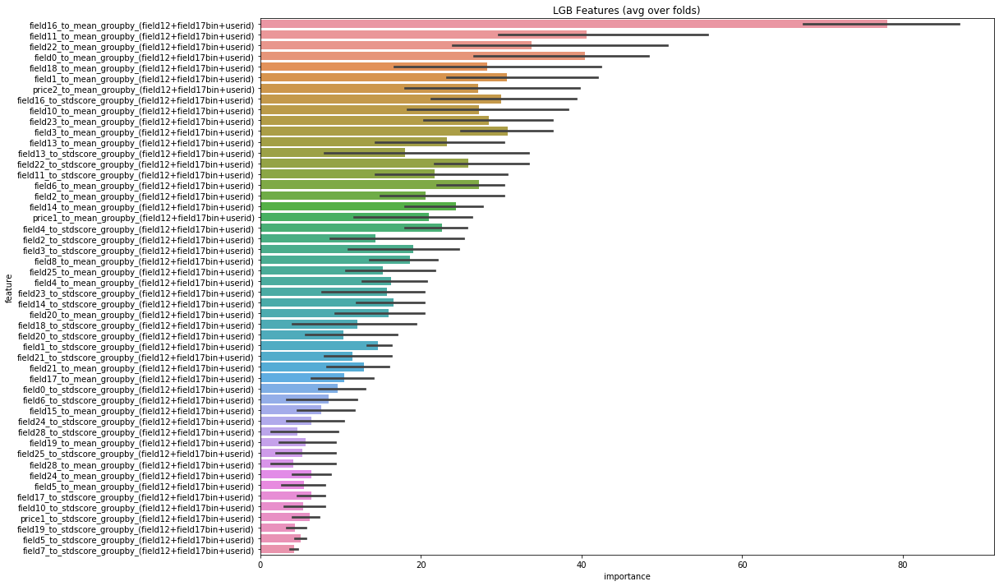

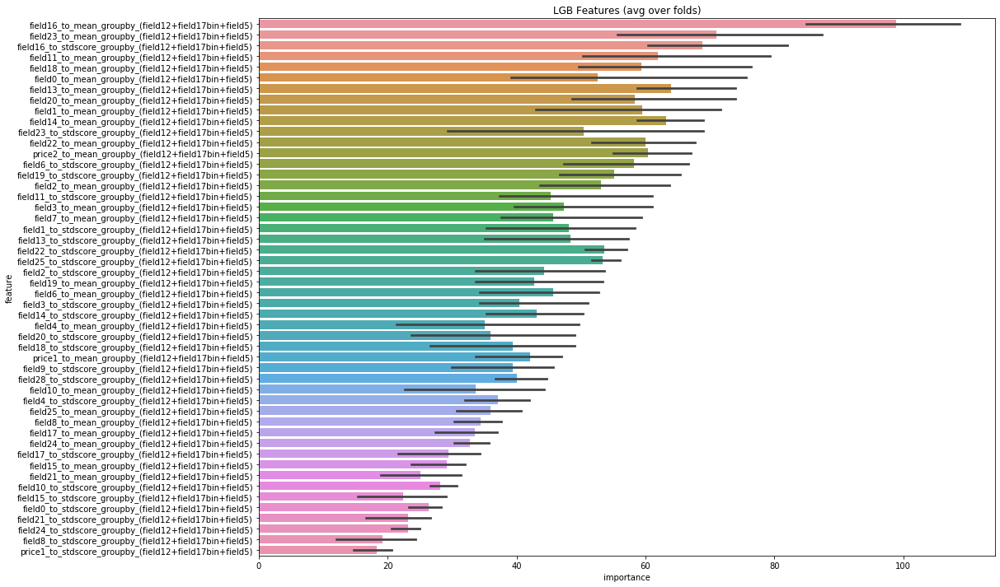

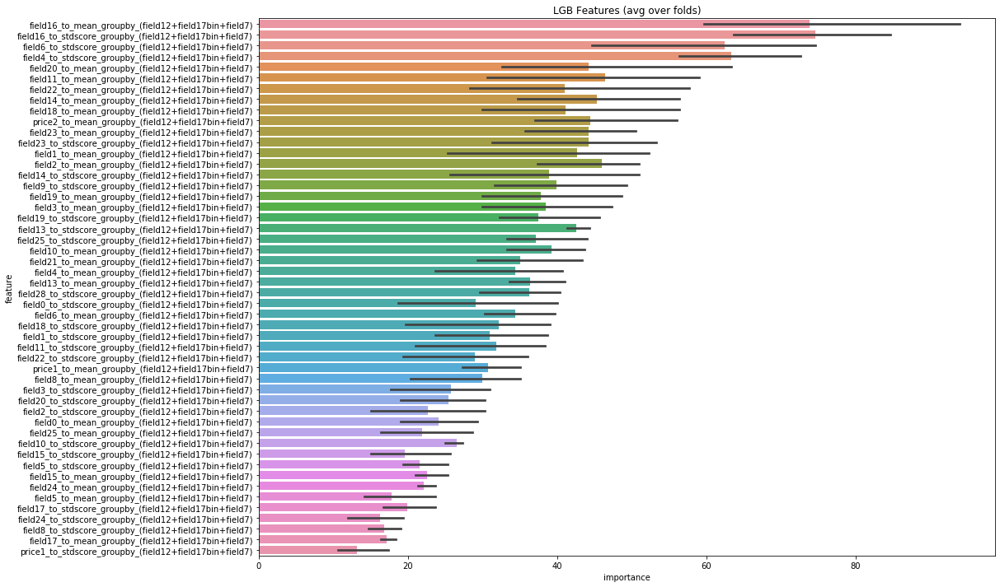

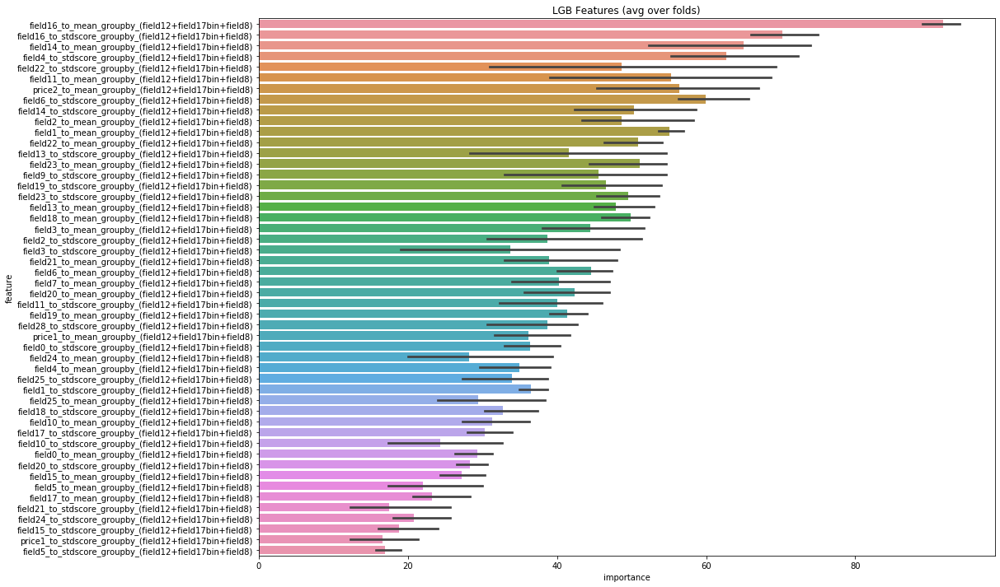

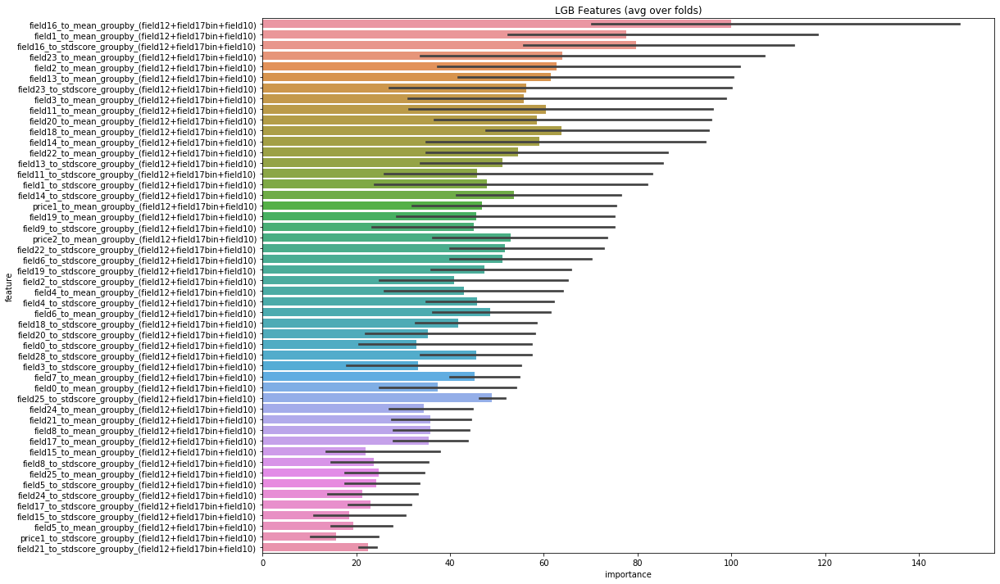

...

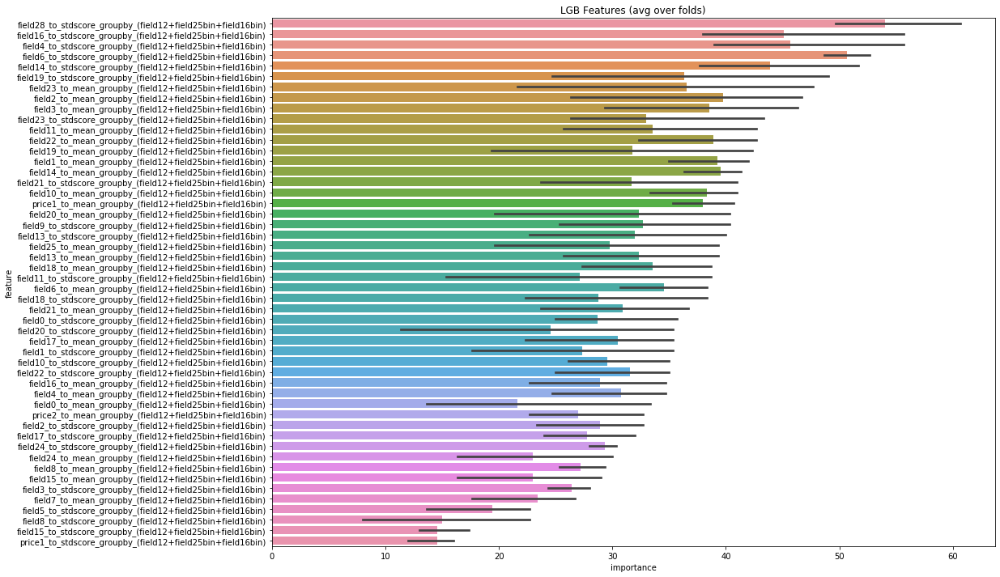

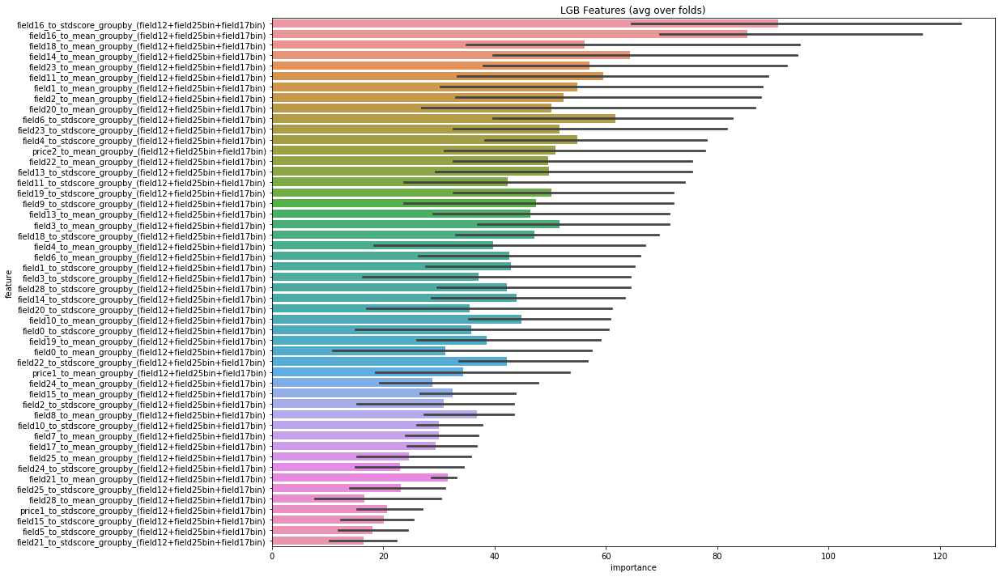

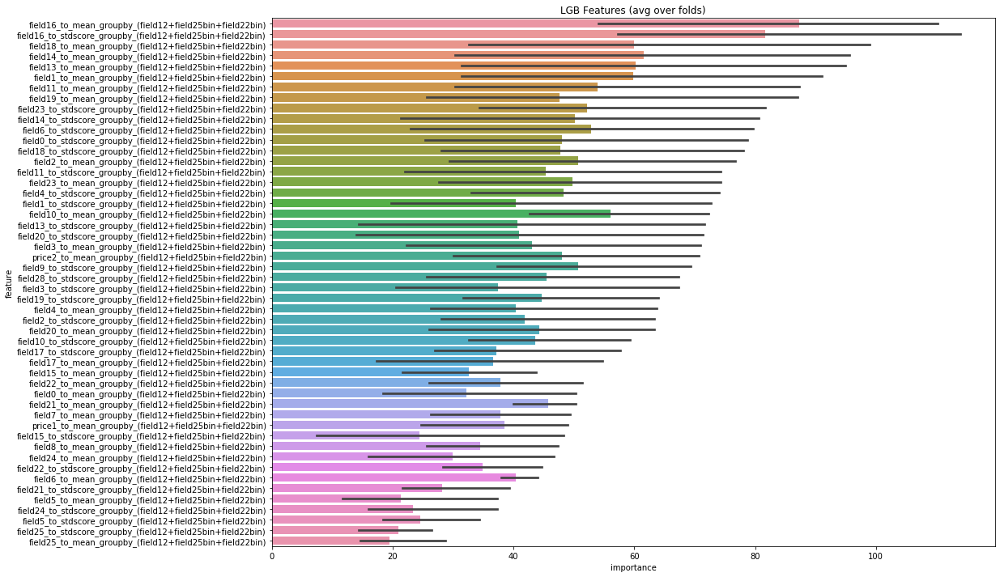

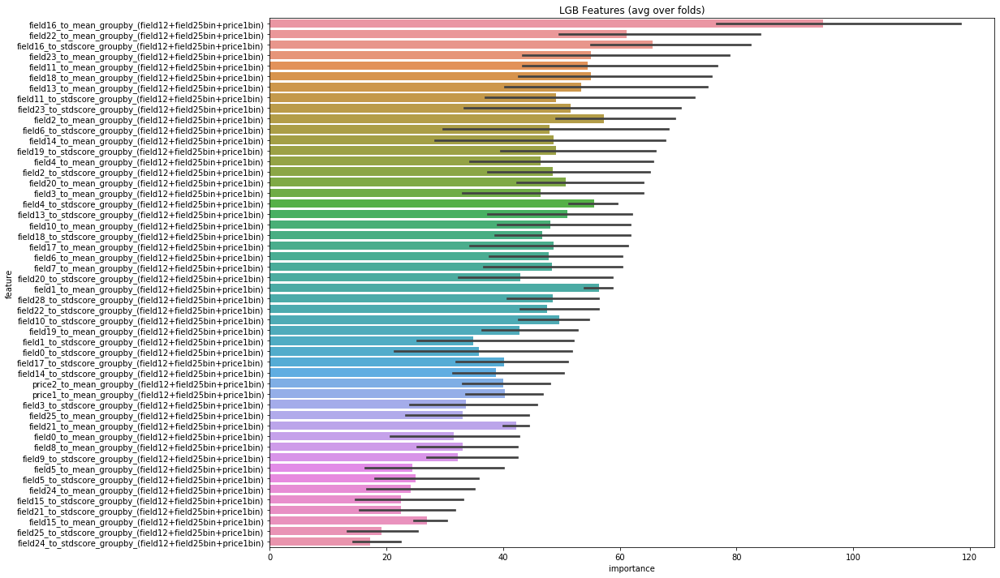

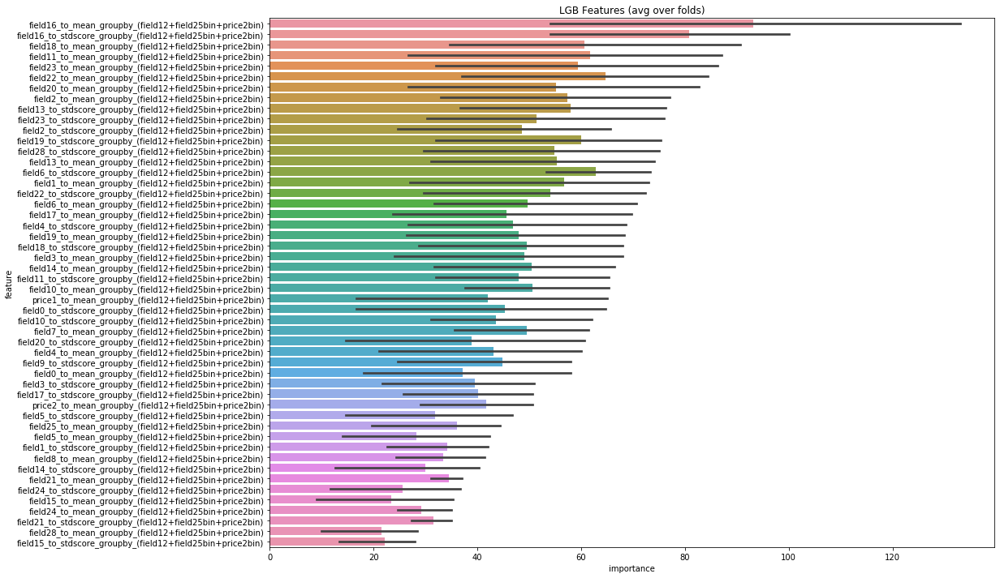

In [41]:
for uf1 in ultimate_features1:
    for uf2 in ultimate_features2:
        for gb in gb_features:
            if gb in (uf1,uf2):
                continue

            print(f'******\n Starting {uf1}+{uf2}+{gb}')
            p.add_node(AddGroupNumericalAggregatesNode, 'data',f'agg_{uf1}_{uf2}_{gb}',
                       params={
                           'features': [f for f in num_features if f not in (uf1,uf2,gb)], 
                           'group_by': [uf1,uf2,gb],
                           'to_mean': True,
                           'to_std_score': True,
                           'to_std': False,
                           'to_minmax': False
                       })
            p.run()    
            X =  p.data[f'agg_{uf1}_{uf2}_{gb}'].loc[train_idx]
            result_dict = train_model_classification_vb( X=X, 
                                                     X_test=None, 
                                                     columns=X.columns,
                                                     y=y, 
                                                     params=params, folds=folds,
                                                     model_type=train_options['model_type'], 
                                                     plot_feature_importance=True,
                                                     verbose=-1, early_stopping_rounds=train_options['early_stopping_rounds'],
                                                     n_estimators=train_options['n_estimators'], 
                                                     averaging=train_options['averaging'],
                                                     groups=groups,
                                                     n_jobs=-1)
            score = sum(result_dict['scores'])/len(result_dict['scores'])
            third_rating[f'agg_{uf1}_{uf2}_{gb}'] = (score, result_dict)
            pickle.dump(third_rating,open("./temp/rating_group_third.pkl",'wb'))
            p.add_node(EraserNode, None,None,
                   params={
                       'remove_keys': [f'agg_{uf1}_{uf2}_{gb}']
                   })
            p.run()
            gc.collect()

In [42]:
rating_scores3 = {k:v[0] for k,v in third_rating.items()}

In [43]:
sorted_rating3 = sorted(rating_scores3.items(),key=lambda q: q[1],reverse=True)

In [44]:
sorted_rating3

[('agg_field12_field27_field10', 0.6827064084845847),
 ('agg_field12_field27_field6bin', 0.6803110227240553),
 ('agg_field12_field6bin_field27', 0.6803110227240553),
 ('agg_field12_field5_field21', 0.6796267109032835),
 ('agg_field12_field6bin_field7', 0.6792534239444601),
 ('agg_field12_field27_field5', 0.6792362961127857),
 ('agg_field12_field5_field27', 0.6792362961127857),
 ('agg_field12_field17bin_field6bin', 0.6788727820185785),
 ('agg_field12_field6bin_field17bin', 0.6788727820185785),
 ('agg_field12_field27_field21', 0.6788017114852617),
 ('agg_field12_field6bin_field8', 0.678790645058413),
 ('agg_field12_field17bin_field7', 0.6787115451542576),
 ('agg_field12_field25bin_field29', 0.6784379594999711),
 ('agg_field12_field17bin_field21', 0.6783155977374227),
 ('agg_field12_field17bin_field10', 0.6782809776966734),
 ('agg_field12_field27_field26', 0.678245632798669),
 ('agg_field12_field6bin_field25bin', 0.6782322227139744),
 ('agg_field12_field25bin_field6bin', 0.678232222713974

In [ ]:
num_features = [0,1,6,9,11,13,14,15,16,17,19,22,23,24,25,28]
groupby_features = [f'field{q}' for q in [5,7,8,10,12,26,27,29]] + ['userid'] + num_bin_features + new_cat_features
for gb in groupby_features:
    p.add_node(AddAggregatesTotalNode, 'data','agg1',
               params={
                   'features': [f'field{q}' for q in num_features],
                   'group_by': gb
               })
p.run()


In [ ]:
# p.add_node(ReduceMemoryUsageNode, 'agg1','agg1',
#                params={
#                    'verbose': True
#                })
# p.run()

In [ ]:
gc.collect()
p.data['agg1'].to_pickle("./FE/agg1.pkl")

In [ ]:
p.add_node(EraserNode, None,None,
               params={
                   'remove_keys': ['agg1']
               })
p.run()

In [16]:
ultimate_features=[26,27,29] # 12,
for u in ultimate_features:
    num_features = [0,1,6,9,11,13,14,15,16,17,19,22,23,24,25,28]
    groupby_features = [f'field{q}' for q in [f for f in ultimate_features if f!=u]] + ['userid'] + num_bin_features + new_cat_features
    for gb in groupby_features:
        p.add_node(AddGroupNumericalAggregatesNode, 'data',f'agg_{u}',
                   params={
                       'features': [f'field{q}' for q in num_features],
                       'group_by': [f'field{u}',gb],
                       'to_mean': True,
                       'to_std_score': True
                   })
    p.run()
    p.data[f'agg_{u}'].to_pickle(f"./FE/agg_{u}.pkl")        
    
    p.add_node(EraserNode, None,None,
               params={
                   'remove_keys': [f'agg_{u}']
               })
    p.run()
    gc.collect()


---------------------------
6: AddGroupNumericalAggregatesNode [2019-12-29 17:50:30]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_by': ['field26', 'field27'], 'to_mean': True, 'to_std_score': True}
---------------------------
7: AddGroupNumericalAggregatesNode [2019-12-29 17:50:34]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_by': ['field26', 'field29'], 'to_mean': True, 'to_std_score': True}
---------------------------
8: AddGroupNumericalAggregatesNode [2019-12-29 17:50:38]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_

---------------------------
30: AddGroupNumericalAggregatesNode [2019-12-29 17:54:23]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_by': ['field27', 'field13bin'], 'to_mean': True, 'to_std_score': True}
---------------------------
31: AddGroupNumericalAggregatesNode [2019-12-29 17:54:34]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_by': ['field27', 'field16bin'], 'to_mean': True, 'to_std_score': True}
---------------------------
32: AddGroupNumericalAggregatesNode [2019-12-29 17:54:45]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28']

---------------------------
54: AddGroupNumericalAggregatesNode [2019-12-29 18:10:24]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_by': ['field29', 'price1bin'], 'to_mean': True, 'to_std_score': True}
---------------------------
55: AddGroupNumericalAggregatesNode [2019-12-29 18:11:24]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 'group_by': ['field29', 'price2bin'], 'to_mean': True, 'to_std_score': True}
---------------------------
56: AddGroupNumericalAggregatesNode [2019-12-29 18:12:46]
params:
 {'features': ['field0', 'field1', 'field6', 'field9', 'field11', 'field13', 'field14', 'field15', 'field16', 'field17', 'field19', 'field22', 'field23', 'field24', 'field25', 'field28'], 

In [13]:
groupby_features = [f'field{q}' for q in [5,7,8,10,12,26,27,29]] + ['userid'] + num_bin_features + new_cat_features
cat_features = groupby_features

for gb in groupby_features:
    p.add_node(AddGroupFrequencyEncodingNode, 'data','agg2',
               params={
                   'features': [c for c in cat_features if c != gb],
                   'group_by': [gb],
                   'count': True,
                   'freq': False
               })
p.run()
p.data[f'agg2'].to_pickle(f"./FE/agg2.pkl")   

---------------------------
6: AddGroupFrequencyEncodingNode [2019-12-29 18:48:40]
params:
 {'features': ['field7', 'field8', 'field10', 'field12', 'field26', 'field27', 'field29', 'userid', 'field0bin', 'field6bin', 'field13bin', 'field16bin', 'field17bin', 'field22bin', 'field25bin', 'price1bin', 'price2bin', 'order_till_hour', 'order_till_weekday', 'order_till_month', 'lang_country', 'all_children', 'has_children'], 'group_by': ['field5'], 'count': True, 'freq': False}
0 field5
---------------------------
7: AddGroupFrequencyEncodingNode [2019-12-29 18:49:16]
params:
 {'features': ['field5', 'field8', 'field10', 'field12', 'field26', 'field27', 'field29', 'userid', 'field0bin', 'field6bin', 'field13bin', 'field16bin', 'field17bin', 'field22bin', 'field25bin', 'price1bin', 'price2bin', 'order_till_hour', 'order_till_weekday', 'order_till_month', 'lang_country', 'all_children', 'has_children'], 'group_by': ['field7'], 'count': True, 'freq': False}
0 field7
---------------------------


0 price1bin
---------------------------
23: AddGroupFrequencyEncodingNode [2019-12-29 18:59:37]
params:
 {'features': ['field5', 'field7', 'field8', 'field10', 'field12', 'field26', 'field27', 'field29', 'userid', 'field0bin', 'field6bin', 'field13bin', 'field16bin', 'field17bin', 'field22bin', 'field25bin', 'price1bin', 'order_till_hour', 'order_till_weekday', 'order_till_month', 'lang_country', 'all_children', 'has_children'], 'group_by': ['price2bin'], 'count': True, 'freq': False}
0 price2bin
---------------------------
24: AddGroupFrequencyEncodingNode [2019-12-29 19:00:15]
params:
 {'features': ['field5', 'field7', 'field8', 'field10', 'field12', 'field26', 'field27', 'field29', 'userid', 'field0bin', 'field6bin', 'field13bin', 'field16bin', 'field17bin', 'field22bin', 'field25bin', 'price1bin', 'price2bin', 'order_till_weekday', 'order_till_month', 'lang_country', 'all_children', 'has_children'], 'group_by': ['order_till_hour'], 'count': True, 'freq': False}
0 order_till_hour
--

KeyError: 'agg_2'

In [14]:
p.data[f'agg2'].to_pickle(f"./FE/agg2.pkl")   

In [ ]:
p.add_node(EraserNode, None,None,
               params={
                   'remove_keys': ['agg2']
               })
p.run()

In [ ]:
# num_features = [0,1,6,9,11,13,14,15,16,17,19,22,23,24,25,28]
# # groupby_features = [f'field{q}' for q in [5,7,8,10,12,26,27,29]] + ['userid']
# # cat_features = groupby_features

# p.add_node(AddTemporalAggregates, 'data','data',
#            params={
#                'features': [f'field{q}' for q in num_features],
#                'group_by': 'userid',
#                'date_field': 'field4',
#                'window': [2,4,8,16]
#            })
# p.run()

In [ ]:
# p.data['data'].to_pickle('./temp/data_with_temporal.pkl')

# # p.save()

In [80]:
f = f'price{2}'
bins = pd.qcut(p.data['data'][f],10, retbins=True, duplicates='drop',precision=3) 

In [82]:
bins[0]

orderid
1000000    (-0.001, 2.0]
1000001       (5.0, 6.0]
1000002    (-0.001, 2.0]
1000003       (2.0, 3.0]
1000004    (-0.001, 2.0]
               ...      
455006     (13.0, 401.0]
455007        (6.0, 7.0]
455008        (7.0, 9.0]
455009     (-0.001, 2.0]
455010        (6.0, 7.0]
Name: price2, Length: 651067, dtype: category
Categories (9, interval[float64]): [(-0.001, 2.0] < (2.0, 3.0] < (3.0, 4.0] < (4.0, 5.0] ... (6.0, 7.0] < (7.0, 9.0] < (9.0, 13.0] < (13.0, 401.0]]

In [21]:
for f in num_to_cat:
    print(f,len(p.data['data'][f'field{f}'].value_counts()))

0 503
1 317
6 212
13 929
14 199
16 332
17 180
22 1050
25 194


In [13]:
p.data['data'].to_pickle('./temp/data_more_categorical_aggs_27_29.pkl')

In [14]:
len(p.data['data'].columns)

1432

## Training


In [69]:
exclude_features_from_training = ['indicator_goal21', 'indicator_goal22', 'indicator_goal23',
       'indicator_goal24', 'indicator_goal25', 'goal21', 'goal22', 'goal23','field12',
       'goal24', 'goal25', 'goal1','userid', 'order_till_hour', 'order_till_weekday', 'order_till_month', 'lang_country']

In [61]:
data = p.data['data']

for col in data.columns:
    if data[col].dtype == 'object' and col != 'userid':
        print(col)
        data[col] = pd.Categorical(data[col])
#     if data[col].dtype

In [70]:
X = data[data['goal1']>=0].drop(['goal1'], axis=1)
y = data[data['goal1']>=0]['goal1']
test=data[data['goal1']<0]
train_features = [f for f in data.columns if f not in exclude_features_from_training]

In [71]:
from sklearn.model_selection import GroupKFold, KFold

NFOLDS = 5
folds = GroupKFold(n_splits=NFOLDS)
params = {
          'objective': 'binary',
          "metric": 'auc',
          "verbosity": -1,
    'learning_rate': 0.01,
    'max_depth':20,
    'num_leaves':50
         }
train_options = {
        "model_type":'lgb',
        "params": params,
        "eval_metric":'auc',
        'early_stopping_rounds': 100,
        'n_estimators': 500,
        'averaging': 'rank',
        'use_groups': False,
        'fold_name': folds.__class__.__name__,
        'n_splits': NFOLDS
    }

Fold 1 started at Fri Dec 20 08:09:14 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.783373	training's auc: 0.783376	valid_1's auc: 0.672257	valid_1's auc: 0.672271
[200]	training's auc: 0.838349	training's auc: 0.83835	valid_1's auc: 0.681522	valid_1's auc: 0.681522
[300]	training's auc: 0.877625	training's auc: 0.877625	valid_1's auc: 0.68447	valid_1's auc: 0.68447
[400]	training's auc: 0.901645	training's auc: 0.901645	valid_1's auc: 0.684089	valid_1's auc: 0.684089
Early stopping, best iteration is:
[322]	training's auc: 0.884313	training's auc: 0.884313	valid_1's auc: 0.684702	valid_1's auc: 0.684702
Fold 2 started at Fri Dec 20 08:14:27 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.77402	training's auc: 0.774022	valid_1's auc: 0.718327	valid_1's auc: 0.718332
[200]	training's auc: 0.834075	training's auc: 0.834075	valid_1's auc: 0.726482	valid_1's auc: 0.726481
[300]	training's auc: 0.87351

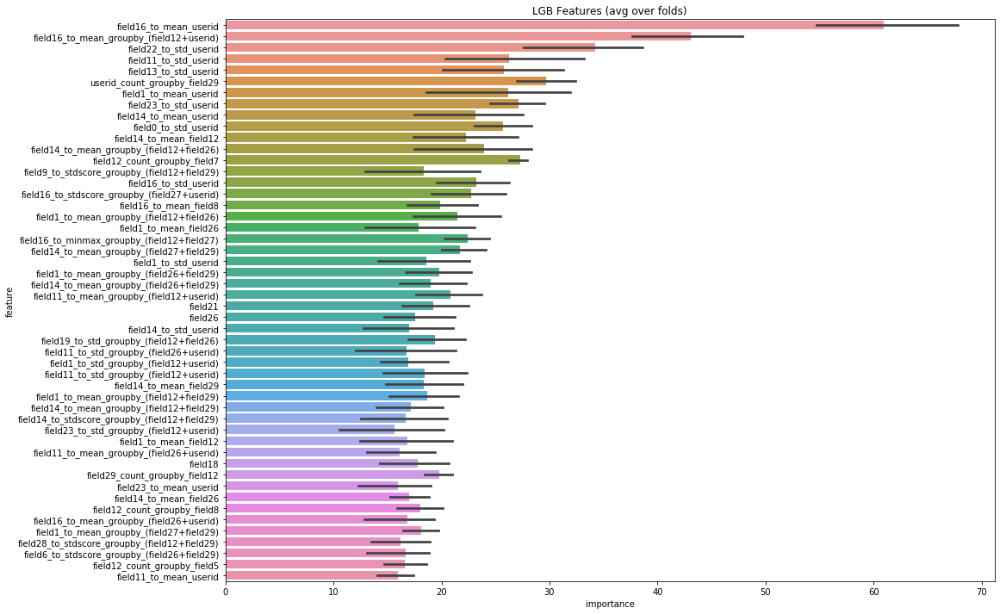

In [72]:
result_dict = train_model_classification_vb( X=X, 
                                             X_test=test, 
                                             columns=train_features,
                                             y=y, 
                                             params=params, folds=folds,
                                             model_type=train_options['model_type'], 
                                             plot_feature_importance=True,
                                             verbose=100, early_stopping_rounds=train_options['early_stopping_rounds'],
                                             n_estimators=train_options['n_estimators'], 
                                             averaging=train_options['averaging'],
                                             groups=X['userid'],
                                             n_jobs=-1)

In [73]:
import datetime
t = datetime.datetime.now().strftime("%m-%d-%H-%M")
test['proba'] = result_dict['prediction']
sub = pd.read_csv('data/onetwotrip_challenge_sub1.csv')
sub['proba'] = test['proba'] / test['proba'].max()
sub.reset_index(drop=True).set_index('orderid').to_csv(f'{p.working_folder}/submission-{t}.csv')

## Goal2

In [19]:
exclude_features_from_training = ['indicator_goal21', 'indicator_goal22', 'indicator_goal23',
       'indicator_goal24', 'indicator_goal25', 'goal21', 'goal22', 'goal23',
       'goal24', 'goal25', 'goal1','userid',]

In [21]:
sub2 = pd.read_csv('data/onetwotrip_challenge_sub2.csv')

In [40]:
sub2.columns = ['orderid', 'goal21', 'goal22', 'goal23', 'goal24', 'goal25']
sub2 = pd.DataFrame(0, columns=sub2.columns, index=sub2.index)

Goal  1
Fold 1 started at Tue Dec 17 16:18:17 2019
Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.875224	training's auc: 0.875224	valid_1's auc: 0.701886	valid_1's auc: 0.701886
[200]	training's auc: 0.925883	training's auc: 0.925883	valid_1's auc: 0.696779	valid_1's auc: 0.696779
Early stopping, best iteration is:
[100]	training's auc: 0.875224	training's auc: 0.875224	valid_1's auc: 0.701886	valid_1's auc: 0.701886
Fold 2 started at Tue Dec 17 16:19:23 2019
Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.876093	training's auc: 0.876093	valid_1's auc: 0.693512	valid_1's auc: 0.693512
Early stopping, best iteration is:
[30]	training's auc: 0.792081	training's auc: 0.792081	valid_1's auc: 0.700029	valid_1's auc: 0.700029
Fold 3 started at Tue Dec 17 16:20:16 2019
Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.879044	training's auc: 0.879044	valid_1's auc: 0.704456	valid_1'

Early stopping, best iteration is:
[20]	training's auc: 0.941855	training's auc: 0.941858	valid_1's auc: 0.906676	valid_1's auc: 0.906645
Fold 4 started at Tue Dec 17 16:38:07 2019
Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.981925	training's auc: 0.981925	valid_1's auc: 0.894457	valid_1's auc: 0.894457
[200]	training's auc: 0.993774	training's auc: 0.993774	valid_1's auc: 0.893544	valid_1's auc: 0.893544
Early stopping, best iteration is:
[113]	training's auc: 0.984797	training's auc: 0.984797	valid_1's auc: 0.894875	valid_1's auc: 0.894875
Fold 5 started at Tue Dec 17 16:38:56 2019
Training until validation scores don't improve for 100 rounds
[100]	training's auc: 0.982665	training's auc: 0.982665	valid_1's auc: 0.897471	valid_1's auc: 0.897471
Early stopping, best iteration is:
[58]	training's auc: 0.969519	training's auc: 0.969519	valid_1's auc: 0.898072	valid_1's auc: 0.898072
CV mean score: 0.9016, std: 0.0060.


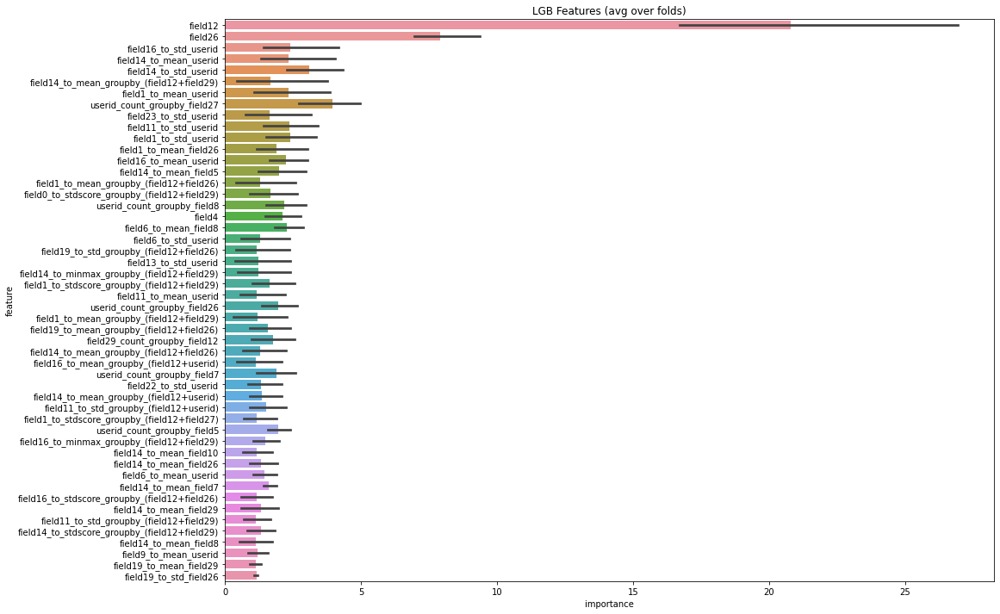

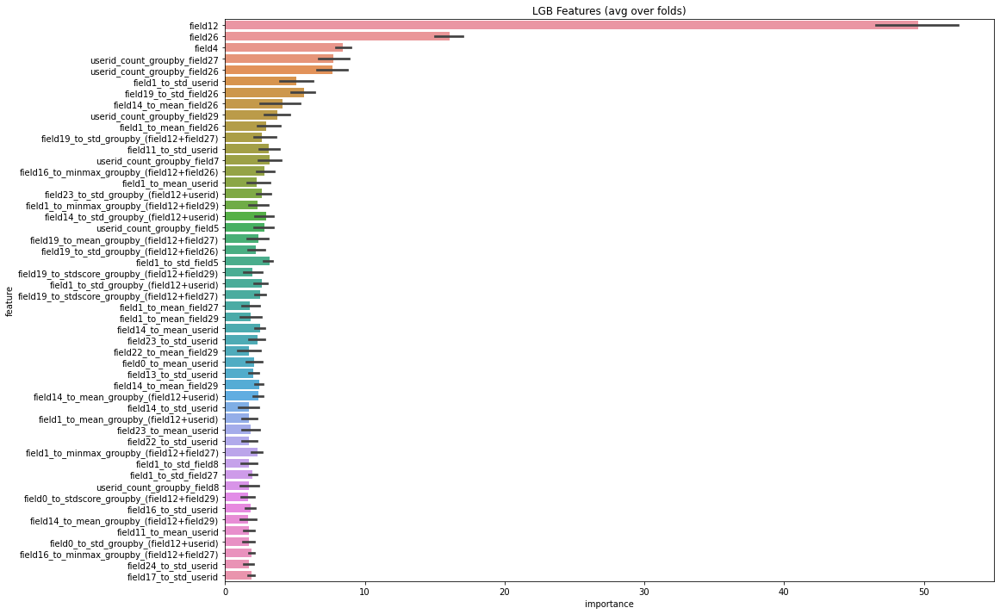

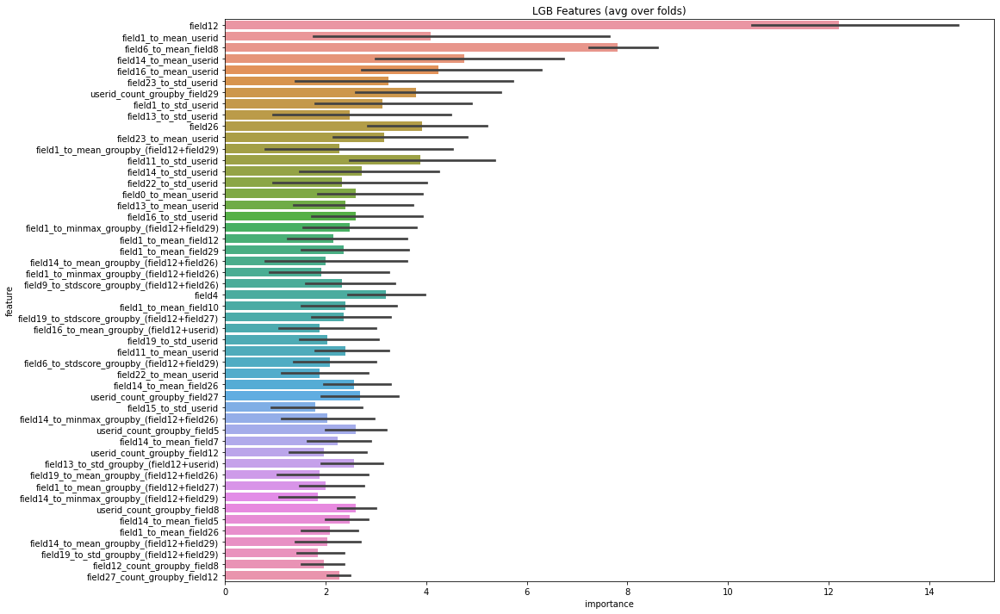

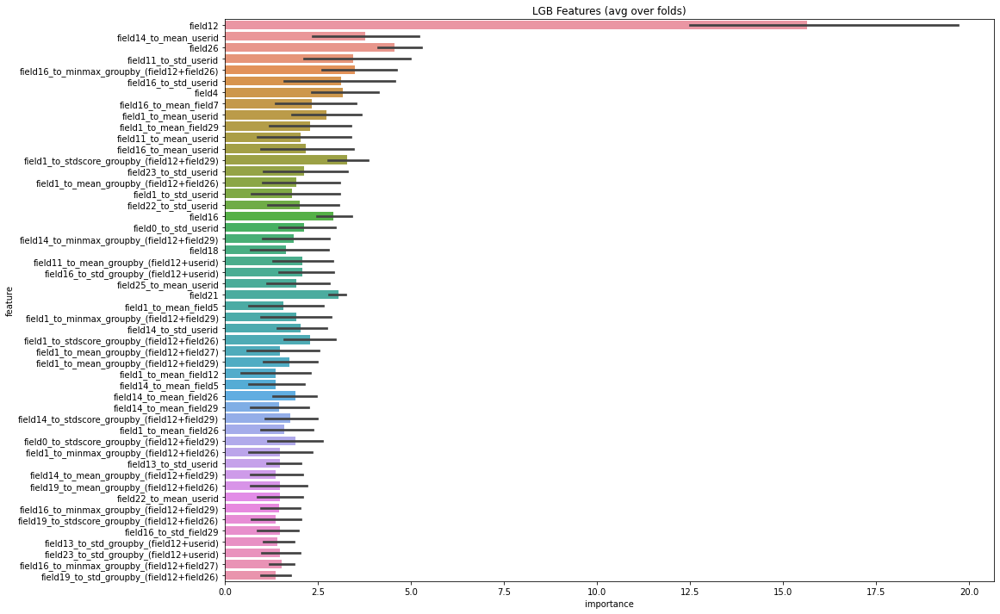

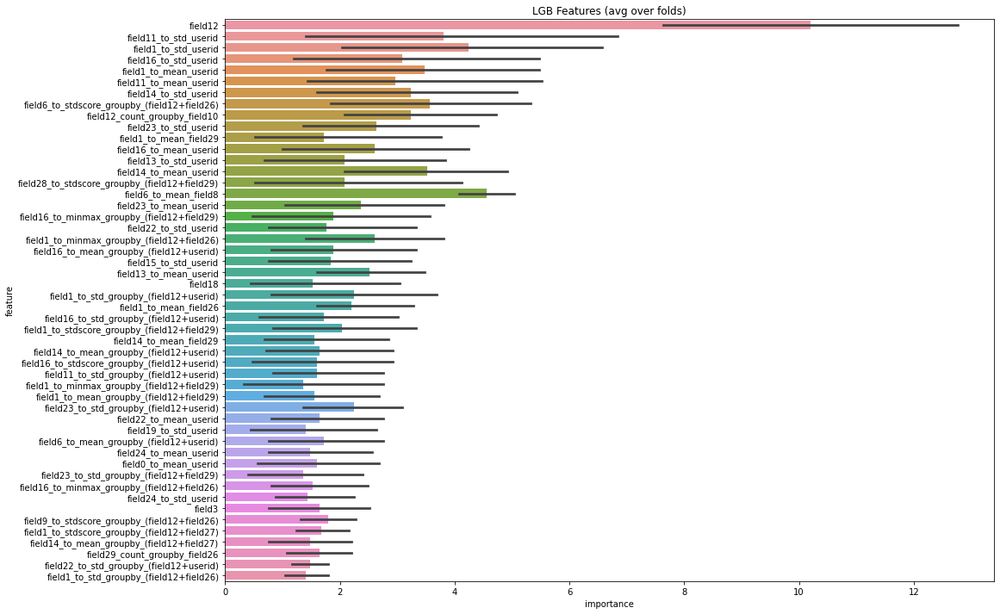

In [41]:
from sklearn.model_selection import GroupKFold, KFold

data = p.data['data']
for i_goal in range(1,6):
    print ("Goal ", i_goal)
    data_filtered = data[data[f'indicator_goal2{i_goal}'] == 1]
    X = data_filtered[data_filtered[f'goal2{i_goal}']>=0].drop([f'goal2{i_goal}'], axis=1)
    y = data_filtered[data_filtered[f'goal2{i_goal}']>=0][f'goal2{i_goal}']
    test=data[data[f'goal2{i_goal}']<0]
    train_features = [f for f in data.columns if f not in exclude_features_from_training]


    NFOLDS = 5
    folds = GroupKFold(n_splits=NFOLDS)
    params = {
              'objective': 'binary',
              "metric": 'auc',
              "verbosity": -1,
             }
    train_options = {
            "model_type":'lgb',
            "params": params,
            "eval_metric":'auc',
            'early_stopping_rounds': 100,
            'n_estimators': 500,
            'averaging': 'rank',
            'use_groups': False,
            'fold_name': folds.__class__.__name__,
            'n_splits': NFOLDS
        }

    result_dict = train_model_classification_vb( X=X, 
                                                 X_test=test, 
                                                 columns=train_features,
                                                 y=y, 
                                                 params=params, folds=folds,
                                                 model_type=train_options['model_type'], 
                                                 plot_feature_importance=True,
                                                 verbose=100, early_stopping_rounds=train_options['early_stopping_rounds'],
                                                 n_estimators=train_options['n_estimators'], 
                                                 averaging=train_options['averaging'],
                                                 groups=X['userid'],
                                                 n_jobs=-1)
    test[f'proba2{i_goal}'] = result_dict['prediction']
    sub2[f'goal2{i_goal}'] = test[f'proba2{i_goal}'] / test[f'proba2{i_goal}'].max()
    
import datetime
t = datetime.datetime.now().strftime("%m-%d-%H-%M")
sub2.reset_index(drop=True).to_csv(f'{p.working_folder}/submission2-{t}.csv')

In [44]:
t = datetime.datetime.now().strftime("%m-%d-%H-%M")
sub2.drop(['orderid'],axis=1).reset_index(drop=True).to_csv(f'{p.working_folder}/submission2-{t}.csv')

## Results

### NO FE. initial

Fold 1 started at Sun Dec 15 19:17:47 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.8352	training's auc: 0.8352	valid_1's auc: 0.660413	valid_1's auc: 0.660413
Early stopping, best iteration is:
[36]	training's auc: 0.769533	training's auc: 0.769533	valid_1's auc: 0.671052	valid_1's auc: 0.671052
Fold 2 started at Sun Dec 15 19:17:58 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.832962	training's auc: 0.832962	valid_1's auc: 0.708005	valid_1's auc: 0.708005
Early stopping, best iteration is:
[27]	training's auc: 0.742707	training's auc: 0.742708	valid_1's auc: 0.71381	valid_1's auc: 0.713811
Fold 3 started at Sun Dec 15 19:18:06 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.833846	training's auc: 0.833846	valid_1's auc: 0.684287	valid_1's auc: 0.684287
Early stopping, best iteration is:
[28]	training's auc: 0.753781	training's auc: 0.753782	valid_1's

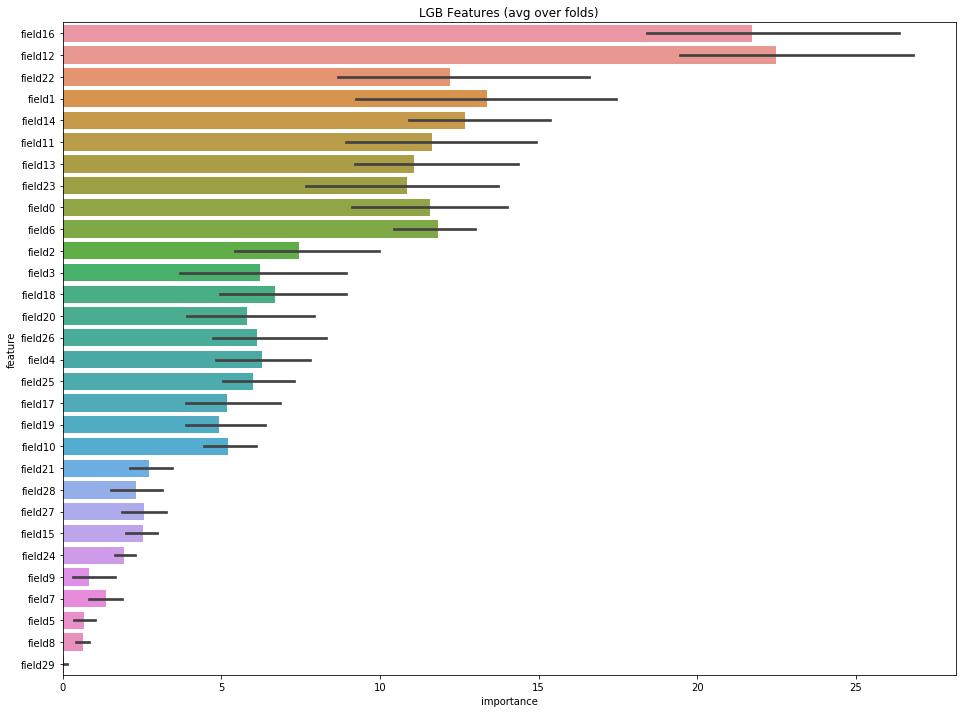

In [22]:
result_dict = train_model_classification_vb( X=X, 
                                             X_test=test, 
                                             columns=train_features,
                                             y=y, 
                                             params=params, folds=folds,
                                             model_type=train_options['model_type'], 
                                             plot_feature_importance=True,
                                             verbose=100, early_stopping_rounds=train_options['early_stopping_rounds'],
                                             n_estimators=train_options['n_estimators'], 
                                             averaging=train_options['averaging'],
                                             groups=X['userid'],
                                             n_jobs=-1)

### add first aggregate node

Fold 1 started at Sun Dec 15 20:21:06 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.892444	training's auc: 0.892444	valid_1's auc: 0.672213	valid_1's auc: 0.672213
Early stopping, best iteration is:
[67]	training's auc: 0.857729	training's auc: 0.857729	valid_1's auc: 0.676682	valid_1's auc: 0.676682
Fold 2 started at Sun Dec 15 20:21:38 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.890783	training's auc: 0.890783	valid_1's auc: 0.705956	valid_1's auc: 0.705956
Early stopping, best iteration is:
[40]	training's auc: 0.817173	training's auc: 0.817173	valid_1's auc: 0.72028	valid_1's auc: 0.720279
Fold 3 started at Sun Dec 15 20:22:05 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.890927	training's auc: 0.890927	valid_1's auc: 0.688385	valid_1's auc: 0.688385
Early stopping, best iteration is:
[33]	training's auc: 0.803194	training's auc: 0.803194	valid

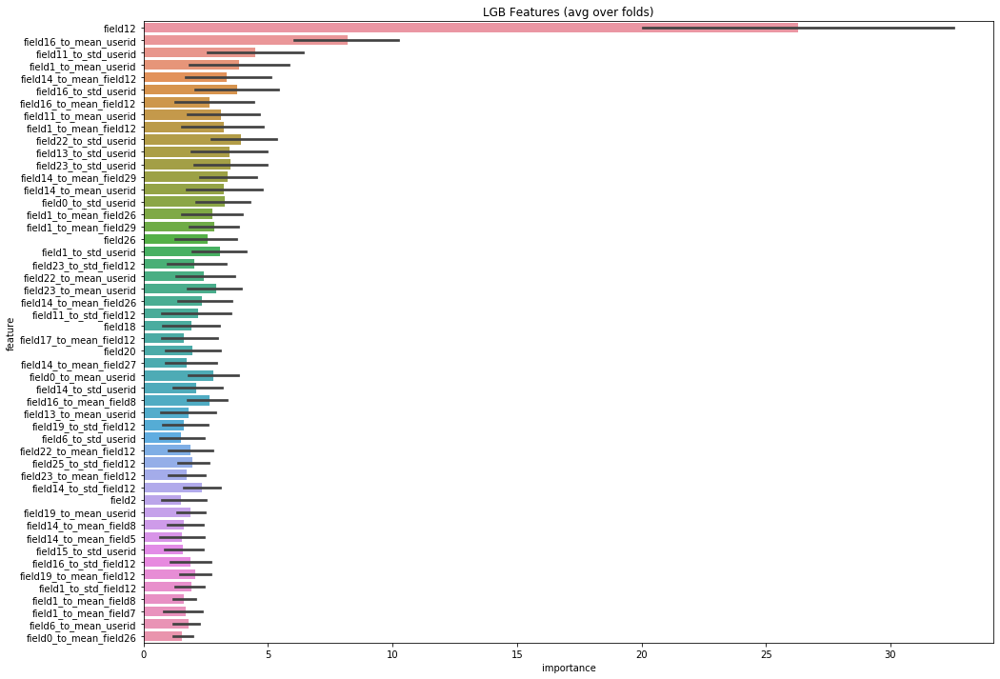

In [13]:
result_dict = train_model_classification_vb( X=X, 
                                             X_test=test, 
                                             columns=train_features,
                                             y=y, 
                                             params=params, folds=folds,
                                             model_type=train_options['model_type'], 
                                             plot_feature_importance=True,
                                             verbose=100, early_stopping_rounds=train_options['early_stopping_rounds'],
                                             n_estimators=train_options['n_estimators'], 
                                             averaging=train_options['averaging'],
                                             groups=X['userid'],
                                             n_jobs=-1)

### More aggregates

Fold 1 started at Mon Dec 16 23:23:56 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.904606	training's auc: 0.904606	valid_1's auc: 0.671887	valid_1's auc: 0.671887
Early stopping, best iteration is:
[50]	training's auc: 0.847829	training's auc: 0.847829	valid_1's auc: 0.676644	valid_1's auc: 0.676644
Fold 2 started at Mon Dec 16 23:24:55 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.900505	training's auc: 0.900505	valid_1's auc: 0.712615	valid_1's auc: 0.712615
Early stopping, best iteration is:
[34]	training's auc: 0.810291	training's auc: 0.810291	valid_1's auc: 0.718987	valid_1's auc: 0.718985
Fold 3 started at Mon Dec 16 23:25:42 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.900145	training's auc: 0.900145	valid_1's auc: 0.694774	valid_1's auc: 0.694774
Early stopping, best iteration is:
[46]	training's auc: 0.84242	training's auc: 0.84242	valid_

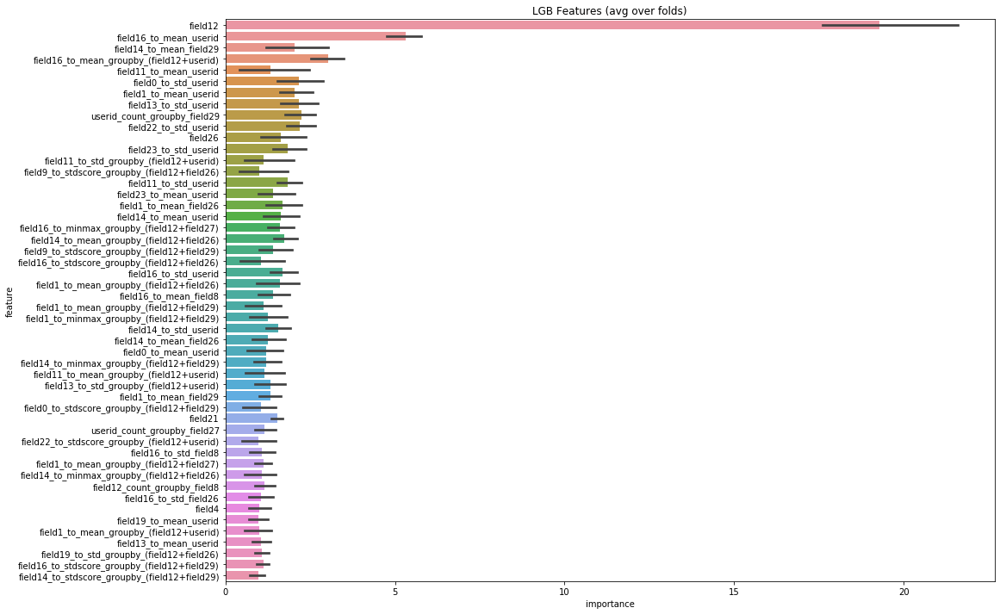

In [15]:
result_dict = train_model_classification_vb( X=X, 
                                             X_test=test, 
                                             columns=train_features,
                                             y=y, 
                                             params=params, folds=folds,
                                             model_type=train_options['model_type'], 
                                             plot_feature_importance=True,
                                             verbose=100, early_stopping_rounds=train_options['early_stopping_rounds'],
                                             n_estimators=train_options['n_estimators'], 
                                             averaging=train_options['averaging'],
                                             groups=X['userid'],
                                             n_jobs=-1)

### Aggs+rfe+tune params (0.6847) - submission_rfe-12-19-20-54.csv

Fold 1 started at Wed Dec 18 21:29:43 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.784354	training's auc: 0.784353	valid_1's auc: 0.671344	valid_1's auc: 0.671339
[200]	training's auc: 0.828908	training's auc: 0.828908	valid_1's auc: 0.676033	valid_1's auc: 0.676032
[300]	training's auc: 0.866599	training's auc: 0.866599	valid_1's auc: 0.678715	valid_1's auc: 0.678715
[400]	training's auc: 0.894881	training's auc: 0.894881	valid_1's auc: 0.679986	valid_1's auc: 0.679986
[500]	training's auc: 0.91094	training's auc: 0.91094	valid_1's auc: 0.67955	valid_1's auc: 0.67955
Did not meet early stopping. Best iteration is:
[500]	training's auc: 0.91094	training's auc: 0.91094	valid_1's auc: 0.67955	valid_1's auc: 0.67955
Fold 2 started at Wed Dec 18 21:32:46 2019
Training until validation scores don't improve for 100 rounds.
[100]	training's auc: 0.771693	training's auc: 0.771689	valid_1's auc: 0.712078	valid_1's auc: 0.71208
[200]	training's auc:

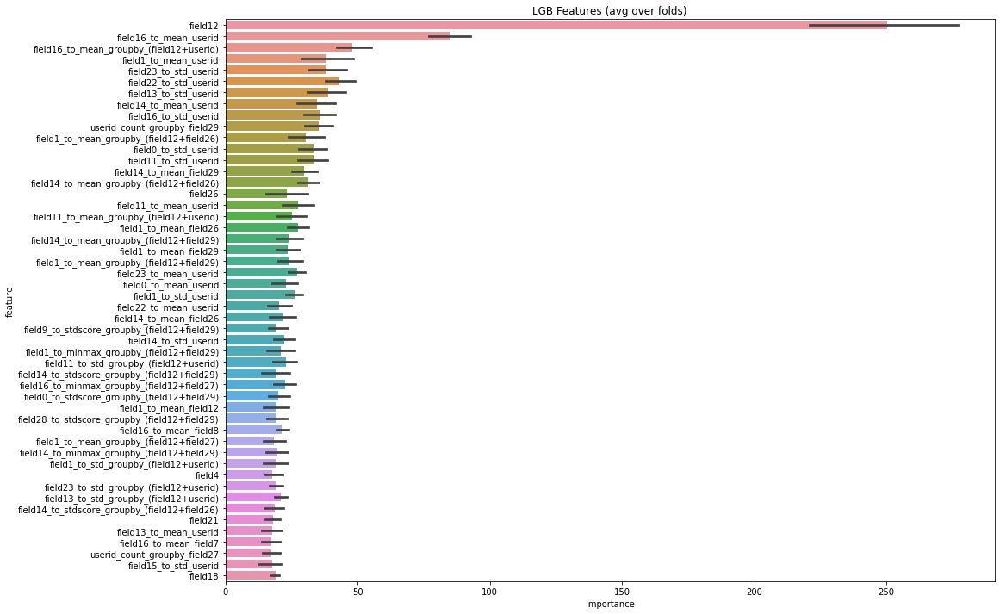

In [19]:
result_dict = train_model_classification_vb( X=X, 
                                             X_test=test, 
                                             columns=train_features,
                                             y=y, 
                                             params=params, folds=folds,
                                             model_type=train_options['model_type'], 
                                             plot_feature_importance=True,
                                             verbose=100, early_stopping_rounds=train_options['early_stopping_rounds'],
                                             n_estimators=train_options['n_estimators'], 
                                             averaging=train_options['averaging'],
                                             groups=X['userid'],
                                             n_jobs=-1)